In [1]:
import pandas as pd
import os
from collections import Counter
import spacy
import torch
from torch.nn.utils.rnn import pad_sequence
import torchvision.transforms as T
import pickle
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import itertools
from collections import Counter
import spacy
import torch
from torch.nn.utils.rnn import pad_sequence
from torch.utils.data import DataLoader,Dataset
import torchvision.transforms as T
from PIL import Image
import torch.nn as nn
import torchvision.models as models
import torch.optim as optim
from datetime import datetime
import pickle
from torchtext.data.metrics import bleu_score
import torch.nn.functional as F

spacy_eng = spacy.load("en")

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
whole_dict = {}
caption_file = '/content/drive/MyDrive/Visual Recognition/Flickr8k_Captions/Flickr8k.token.txt'
df = pd.read_csv(caption_file, delimiter="\t", header=None, engine='python', names=['image', 'caption'])
print("There are {} image to captions".format(len(df)))
df[['image','no']] = df['image'].str.split('#',expand=True)
print("No of Unique images =", int(df.shape[0]/5))
df.drop(columns=["no"], inplace=True)
df.head(5)

There are 40460 image to captions
No of Unique images = 8092


,image,caption
0,1000268201_693b08cb0e.jpg,A child in a pink dress is climbing up a set o...
1,1000268201_693b08cb0e.jpg,A girl going into a wooden building .
2,1000268201_693b08cb0e.jpg,A little girl climbing into a wooden playhouse .
3,1000268201_693b08cb0e.jpg,A little girl climbing the stairs to her playh...
4,1000268201_693b08cb0e.jpg,A little girl in a pink dress going into a woo...


In [4]:
train_caption_file = '/content/drive/MyDrive/Visual Recognition/Flickr8k_Captions/Flickr_8k.trainImages.txt'
val_caption_file = '/content/drive/MyDrive/Visual Recognition/Flickr8k_Captions/Flickr_8k.valImages.txt'
test_caption_file = '/content/drive/MyDrive/Visual Recognition/Flickr8k_Captions/Flickr_8k.testImages.txt'

train_captions_df = pd.read_csv(train_caption_file, header = None, delimiter="\n", names=["image"])
val_captions_df = pd.read_csv(val_caption_file, header = None, delimiter="\n", names=["image"])
test_captions_df = pd.read_csv(test_caption_file, header = None, delimiter="\n", names=["image"])
print("Train captions =", train_captions_df.shape)
print("Val captions =", val_captions_df.shape)
print("Test captions =", test_captions_df.shape)

train_df = pd.merge(df, train_captions_df, on=['image'], how='inner')
val_df = pd.merge(df, val_captions_df, on=['image'], how='inner')
test_df = pd.merge(df, test_captions_df, on=['image'], how='inner')
print("Only Train captions =", train_df.shape)
print("Only Val captions =", val_df.shape)
print("Only Test captions =", test_df.shape)

Train captions = (6000, 1)
Val captions = (1000, 1)
Test captions = (1000, 1)
Only Train captions = (30000, 2)
Only Val captions = (5000, 2)
Only Test captions = (5000, 2)


In [5]:
class Vocabulary:
    def __init__(self,freq_threshold):
        #setting the pre-reserved tokens int to string tokens
        self.itos = {0:"<PAD>",1:"<SOS>",2:"<EOS>",3:"<UNK>"}
        
        #string to int tokens
        #its reverse dict self.itos
        self.stoi = {v:k for k,v in self.itos.items()}
        
        self.freq_threshold = freq_threshold
        
    def __len__(self): return len(self.itos)
    
    @staticmethod
    def tokenize(text):
        return [token.text.lower() for token in spacy_eng.tokenizer(text)]
    
    def build_vocab(self, sentence_list):
        frequencies = Counter()
        idx = 4
        
        for sentence in sentence_list:
            for word in self.tokenize(sentence):
                frequencies[word] += 1
                
                #add the word to the vocab if it reaches minum frequecy threshold
                if frequencies[word] == self.freq_threshold:
                    self.stoi[word] = idx
                    self.itos[idx] = word
                    idx += 1
    
    def numericalize(self,text):
        """ For each word in the text corresponding index token for that word form the vocab built as list """
        tokenized_text = self.tokenize(text)
        return [ self.stoi[token] if token in self.stoi else self.stoi["<UNK>"] for token in tokenized_text ]    

In [6]:
class FlickrDataset(Dataset):
    """
    FlickrDataset
    """
    def __init__(self,root_dir,dataFrame,transform=None,freq_threshold=5):
        self.root_dir = root_dir
        # self.df = pd.read_csv(caption_file)
        self.df = dataFrame
        self.transform = transform
        
        #Get image and caption colum from the dataframe
        self.imgs = self.df["image"]
        self.captions = self.df["caption"]
        
        #Initialize vocabulary and build vocab
        self.vocab = Vocabulary(freq_threshold)
        self.vocab.build_vocab(self.captions.tolist())
        
    
    def __len__(self):
        return len(self.df)
    
    def __getitem__(self,idx):
        caption = self.captions[idx]
        img_name = self.imgs[idx]
        img_location = os.path.join(self.root_dir,img_name)
        img = Image.open(img_location).convert("RGB")
        
        #apply the transfromation to the image
        if self.transform is not None:
            img = self.transform(img)
        
        #numericalize the caption text
        caption_vec = []
        caption_vec += [self.vocab.stoi["<SOS>"]]
        caption_vec += self.vocab.numericalize(caption)
        caption_vec += [self.vocab.stoi["<EOS>"]]
        
        return img, torch.tensor(caption_vec)

In [7]:
class CapsCollate:
    """
    Collate to apply the padding to the captions with dataloader
    """
    def __init__(self,pad_idx,batch_first=False):
        self.pad_idx = pad_idx
        self.batch_first = batch_first
    
    def __call__(self,batch):
        imgs = [item[0].unsqueeze(0) for item in batch]
        imgs = torch.cat(imgs,dim=0)
        
        targets = [item[1] for item in batch]
        targets = pad_sequence(targets, batch_first=self.batch_first, padding_value=self.pad_idx)
        return imgs,targets

In [8]:
#for image plot
import matplotlib.pyplot as plt
def show_image(img, title=None):
    """Imshow for Tensor."""
    
    #unnormalize 
    img[0] = img[0] * 0.229
    img[1] = img[1] * 0.224 
    img[2] = img[2] * 0.225 
    img[0] += 0.485 
    img[1] += 0.456 
    img[2] += 0.406
    
    img = img.numpy().transpose((1, 2, 0))
    
    
    plt.imshow(img)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)  # pause a bit so that plots are updated

In [9]:
#setting the constants
# data_location = '/content/drive/MyDrive/Visual Recognition/Flickr8K'
# BATCH_SIZE = 32
# NUM_WORKER = 2

# #defining the transform to be applied
# transforms = T.Compose([
#     T.Resize(300),                     
#     T.RandomCrop(299),                 
#     T.ToTensor(),                               
#     T.Normalize((0.485, 0.456, 0.406),(0.229, 0.224, 0.225))
# ])


# # testing the dataset class
# dataset =  FlickrDataset(
#     root_dir = data_location+"/Flicker8k_Images",
#     dataFrame = train_df,
#     transform=transforms
# )

# pad_idx = dataset.vocab.stoi["<PAD>"]

# #writing the dataloader
# data_loader = DataLoader(
#     dataset=dataset,
#     batch_size=BATCH_SIZE,
#     num_workers=NUM_WORKER,
#     shuffle=True,
#     collate_fn=CapsCollate(pad_idx=pad_idx,batch_first=True)
# )

# pickle.dump(data_loader, open("/content/drive/MyDrive/Visual Recognition/train_dataloader_batch_size_32.p","wb"))

filename = "/content/drive/MyDrive/Visual Recognition/DataLoader/train_dataloader_batch_size_32.p" # pratap
filehandler = open(filename, 'rb') 
data_loader = pickle.load(filehandler)

In [10]:
class EncoderCNN(nn.Module):
    def __init__(self, embed_size):
        super(EncoderCNN, self).__init__()
        resnet = models.googlenet(pretrained=True)
        for param in resnet.parameters():
            param.requires_grad_(False)
        
        modules = list(resnet.children())[:-1]
        self.resnet = nn.Sequential(*modules)
        self.embed = nn.Linear(resnet.fc.in_features, embed_size)

    def forward(self, images):
        features = self.resnet(images)
        features = features.view(features.size(0), -1)
        features = self.embed(features)
        return features

In [11]:
class DecoderRNN(nn.Module):
    def __init__(self,embed_size, hidden_size, vocab_size, num_layers=1,drop_prob=0.3):
        super().__init__()
        self.embedding = nn.Embedding(vocab_size,embed_size)
        self.lstm = nn.LSTM(embed_size,hidden_size,num_layers=num_layers,batch_first=True)
        self.fcn = nn.Linear(hidden_size,vocab_size)
        self.drop = nn.Dropout(drop_prob)
    
    def forward(self, features, captions):
        
        #vectorize the caption
        embeds = self.embedding(captions[:,:-1])
        
        #concat the features and captions
        x = torch.cat((features.unsqueeze(1),embeds),dim=1) 
        x,_ = self.lstm(x)
        x = self.fcn(x)
        return x
    
    def generate_caption(self,inputs,hidden=None,max_len=20,vocab=None):
        # Inference part
        # Given the image features generate the captions
        
        batch_size = inputs.size(0)
        
        captions = []
        
        for i in range(max_len):
            output,hidden = self.lstm(inputs,hidden)
            output = self.fcn(output)
            output = output.view(batch_size,-1)
        
            
            #select the word with most val
            predicted_word_idx = output.argmax(dim=1)
            
            #save the generated word
            captions.append(predicted_word_idx.item())
            
            #end if <EOS detected>
            if vocab.itos[predicted_word_idx.item()] == "<EOS>":
                break
            
            #send generated word as the next caption
            inputs = self.embedding(predicted_word_idx.unsqueeze(0))
        
        #covert the vocab idx to words and return sentence
        return [vocab.itos[idx] for idx in captions]

In [12]:
 class EncoderDecoder(nn.Module):
    def __init__(self,embed_size, hidden_size, vocab_size, num_layers=1,drop_prob=0.3):
        super().__init__()
        self.encoder = EncoderCNN(embed_size)
        self.decoder = DecoderRNN(embed_size,hidden_size,vocab_size,num_layers,drop_prob)
    
    def forward(self, images, captions):
        features = self.encoder(images)
        outputs = self.decoder(features, captions)
        return outputs

In [13]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
device

device(type='cuda')

In [14]:
# Hyperparameters
embed_size = 400
hidden_size = 512
vocab_size = len(data_loader.dataset.vocab)
num_layers = 2
learning_rate = 0.0001
# num_epochs = 2

In [15]:
# initialize model, loss etc
model = EncoderDecoder(embed_size, hidden_size, vocab_size, num_layers).to(device)
criterion = nn.CrossEntropyLoss(ignore_index=data_loader.dataset.vocab.stoi["<PAD>"])
optimizer = optim.Adam(model.parameters(), lr=learning_rate)

Downloading: "https://download.pytorch.org/models/googlenet-1378be20.pth" to /root/.cache/torch/hub/checkpoints/googlenet-1378be20.pth


In [16]:
#helper function to save the model
def save_model(model, num_epochs, encoder, decoder):
    model_state = {
        'num_epochs':num_epochs,
        # 'embed_size':embed_size,
        'vocab_size':len(data_loader.dataset.vocab),
        # 'attention_dim':attention_dim,
        # 'encoder_dim':encoder_dim,
        # 'decoder_dim':decoder_dim,
        'state_dict':model.state_dict(),
        'encoder':encoder,
        'decoder':decoder,
        'model':model
    }

    torch.save(model_state,'/content/drive/MyDrive/Visual Recognition/Models/WithoutAttentionModel_Resnet18_BS_32_trial.pth')

In [17]:
def calculate_bleu_score(data_loader) :
  model1 = torch.load('/content/drive/MyDrive/Visual Recognition/WithoutAttentionModel_Resnet18_BS_32.pth')
  caption_needed =[]
  predicted_split_caps =[]
  with torch.no_grad():
    dataiter = iter(data_loader)
    img, ref_captions = next(dataiter)
    features = model1.get('encoder')(img[0:1].to(device))
    caps = model1.get('decoder').generate_caption(features.unsqueeze(0),vocab=data_loader.dataset.vocab)
    caption = ' '.join(caps)
    show_image(img[0],title=caption)
    caption_needed = [data_loader.dataset.vocab.itos[idx] if idx in data_loader.dataset.vocab.itos else  data_loader.dataset.vocab.itos[3] for idx in ref_captions[0].detach().numpy()]
    print('Actual caption =', caption_needed)
    predicted_split_caps = caption.split(' ')
    print('Predicted caption =', caption.split(' '))
    len_diff = abs(len(caption_needed) - len(predicted_split_caps))
    list_pad = ['<PAD>'] * len_diff
    if len(caption_needed) > len(predicted_split_caps):
      predicted_split_caps.extend(list_pad)
    else :
      caption_needed.extend(list_pad)
  predicted_split_caps.insert(0, '<SOS>')
  caption_needed = [[caption_needed]]
  predicted_split_caps =[predicted_split_caps]
  # print(model1.get('num_epochs'))
  print(bleu_score(predicted_split_caps, caption_needed, max_n=2, weights=[0.25, 0.25]))

In [18]:
epoch_no = 0
if os.path.isfile('/content/drive/MyDrive/Visual Recognition/Models/WithoutAttentionModel_Resnet18_BS_32_trial.pth'):
  model = torch.load('/content/drive/MyDrive/Visual Recognition/Models/WithoutAttentionModel_Resnet18_BS_32_trial.pth')
  epoch_no = model.get('num_epochs')
  model = model.get('model')
print('Starting from epoch no :', epoch_no + 1)

Starting from epoch no : 10


Start Epoch: 10   Hour: 2  Minutes : 46
Epoch: 10 loss: 2.37926


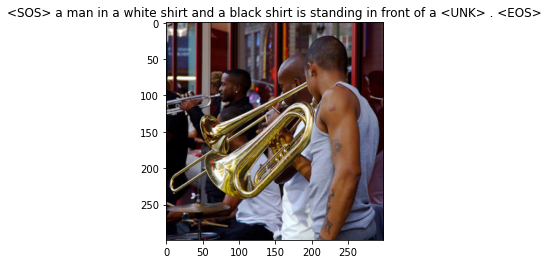

Actual caption = ['<SOS>', 'men', 'play', '<UNK>', 'outside', 'a', 'building', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'white', 'shirt', 'and', 'a', 'black', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.4014531075954437
Epoch: 10 loss: 2.24952


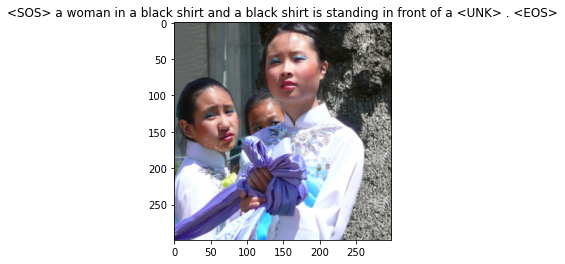

Actual caption = ['<SOS>', 'two', 'woman', 'stand', 'together', 'and', 'one', 'holds', 'a', 'purple', 'cloth', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'woman', 'in', 'a', 'black', 'shirt', 'and', 'a', 'black', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.5053483247756958
Epoch: 10 loss: 2.24185


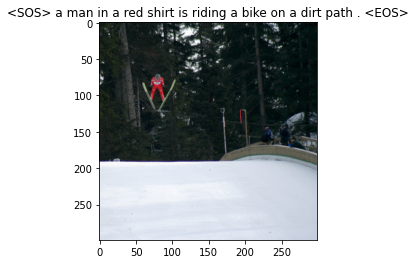

Actual caption = ['<SOS>', 'a', 'skier', 'catches', 'air', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'riding', 'a', 'bike', 'on', 'a', 'dirt', 'path', '.', '<EOS>']
0.6170036196708679
Epoch: 10 loss: 2.29520


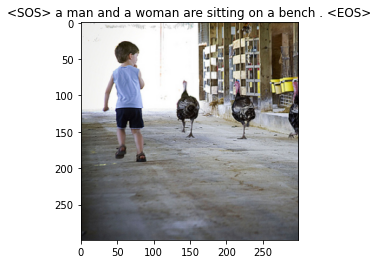

Actual caption = ['<SOS>', 'a', 'small', 'boy', 'following', '4', 'geese', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'and', 'a', 'woman', 'are', 'sitting', 'on', 'a', 'bench', '.', '<EOS>']
0.6773710250854492
Epoch: 10 loss: 2.33230


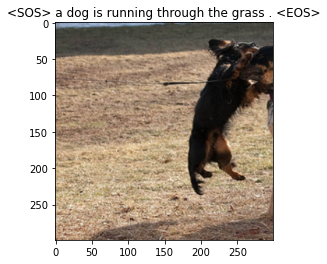

Actual caption = ['<SOS>', 'a', 'large', 'dog', 'holding', 'a', 'smaller', 'dog', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'the', 'grass', '.', '<EOS>']
0.8566209077835083
Epoch: 10 loss: 2.27711


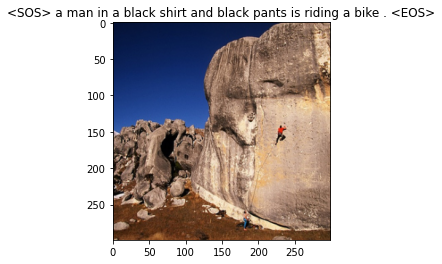

Actual caption = ['<SOS>', 'two', 'people', 'rock', 'climbing', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'black', 'pants', 'is', 'riding', 'a', 'bike', '.', '<EOS>']
0.6170036196708679
Epoch: 10 loss: 2.47815


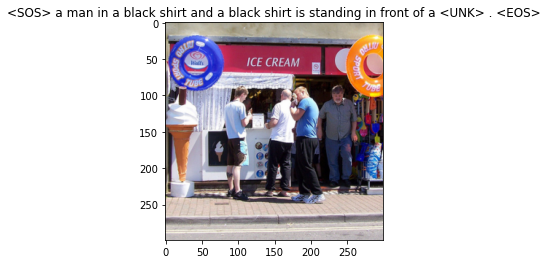

Actual caption = ['<SOS>', 'people', 'outside', 'an', 'ice', 'cream', 'shop', 'that', 'has', 'summer', '<UNK>', 'for', '<UNK>', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'a', 'black', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.4244849979877472
Epoch: 10 loss: 2.44501


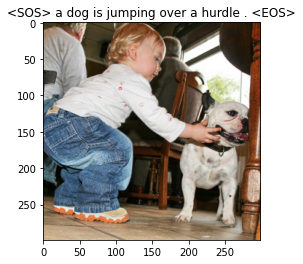

Actual caption = ['<SOS>', 'a', 'toddler', 'is', 'petting', 'the', 'little', 'white', 'dog', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'jumping', 'over', 'a', 'hurdle', '.', '<EOS>']
0.8444671630859375
Epoch: 10 loss: 2.60017


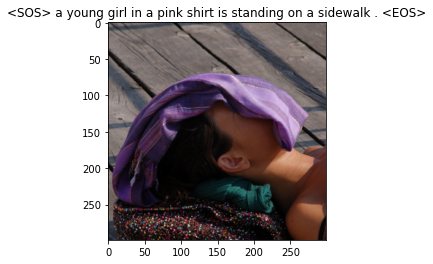

Actual caption = ['<SOS>', 'a', 'girl', 'is', '<UNK>', 'herself', 'with', 'a', 'purple', 'towel', 'over', 'her', 'face', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'standing', 'on', 'a', 'sidewalk', '.', '<EOS>']
0.8106347918510437
End Epoch: 10   Hour: 3  Minutes : 22
****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

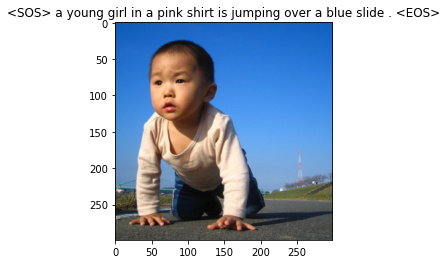

Actual caption = ['<SOS>', 'an', 'asian', 'baby', 'crawling', 'on', 'a', 'road', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'jumping', 'over', 'a', 'blue', 'slide', '.', '<EOS>']
0.6098694801330566
Epoch: 11 loss: 2.21991


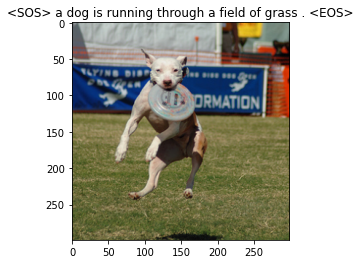

Actual caption = ['<SOS>', 'the', 'dog', 'jumps', 'to', 'catch', 'the', 'frisbee', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'a', 'field', 'of', 'grass', '.', '<EOS>']
0.712104320526123
Epoch: 11 loss: 2.36185


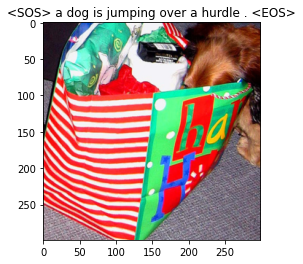

Actual caption = ['<SOS>', 'the', 'red', '-', 'brown', 'dog', 'digs', 'his', 'nose', 'to', '<UNK>', 'a', '<UNK>', '<UNK>', 'bag', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'jumping', 'over', 'a', 'hurdle', '.', '<EOS>']
0.6682634949684143
Epoch: 11 loss: 2.48532


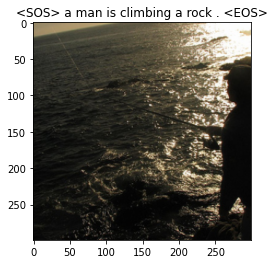

Actual caption = ['<SOS>', 'person', 'fishing', 'in', 'large', 'body', 'of', 'water', 'with', 'low', 'sunlight', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'is', 'climbing', 'a', 'rock', '.', '<EOS>']
0.7274271249771118
Epoch: 11 loss: 2.37111


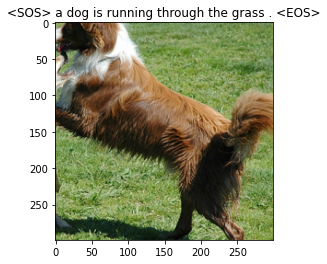

Actual caption = ['<SOS>', 'two', 'dogs', 'playing', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'the', 'grass', '.', '<EOS>']
0.7765453457832336
Epoch: 11 loss: 2.30466


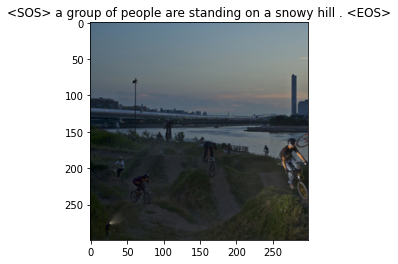

Actual caption = ['<SOS>', 'the', 'teenagers', 'are', 'performing', 'tricks', 'on', 'their', 'bicycles', 'at', 'night', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'standing', 'on', 'a', 'snowy', 'hill', '.', '<EOS>']
0.6709293127059937
Epoch: 11 loss: 2.32821


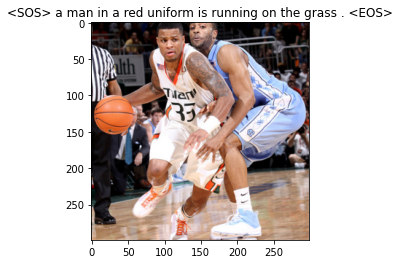

Actual caption = ['<SOS>', 'a', 'basketball', 'player', 'in', 'blue', 'is', 'attempting', 'to', 'block', 'a', 'player', 'in', 'white', 'during', 'a', 'game', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'uniform', 'is', 'running', 'on', 'the', 'grass', '.', '<EOS>']
0.650891125202179
Epoch: 11 loss: 2.28997


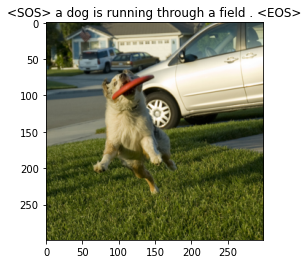

Actual caption = ['<SOS>', 'a', 'white', 'dog', 'catches', 'a', 'red', 'frisbee', 'in', 'the', 'grass', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'a', 'field', '.', '<EOS>']
0.755672037601471
Epoch: 11 loss: 2.35880


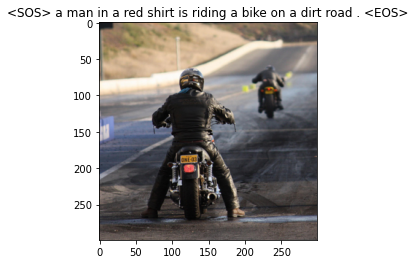

Actual caption = ['<SOS>', 'a', 'biker', '<UNK>', 'waits', 'as', 'his', 'friend', 'bikes', 'ahead', 'of', 'him', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'riding', 'a', 'bike', 'on', 'a', 'dirt', 'road', '.', '<EOS>']
0.5940151214599609
End Epoch: 11   Hour: 3  Minutes : 46
*****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

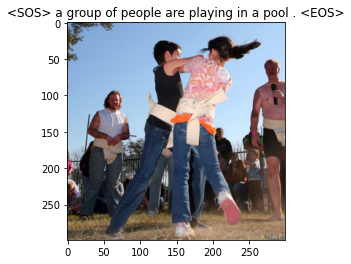

Actual caption = ['<SOS>', 'two', 'girls', 'dressed', 'up', 'with', 'sumo', 'pants', 'wrestling', 'while', 'people', 'look', 'on', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'playing', 'in', 'a', 'pool', '.', '<EOS>']
0.6976729035377502
Epoch: 12 loss: 2.18749


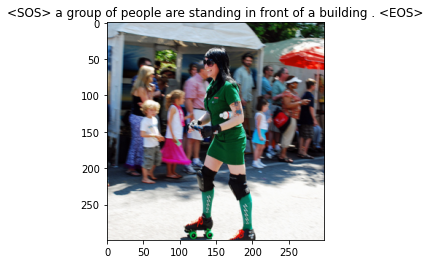

Actual caption = ['<SOS>', 'a', 'woman', 'dressed', 'in', 'green', 'is', 'rollerskating', 'outside', 'at', 'an', 'event', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'standing', 'in', 'front', 'of', 'a', 'building', '.', '<EOS>']
0.695337176322937
Epoch: 12 loss: 2.40971


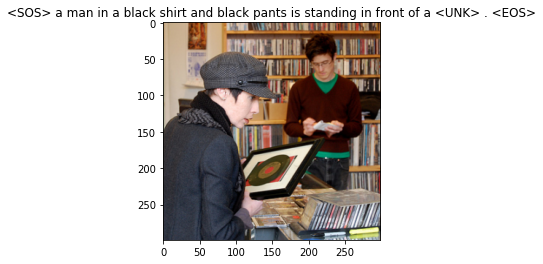

Actual caption = ['<SOS>', 'a', 'girl', 'and', 'a', 'guy', 'shop', 'for', '<UNK>', 'in', 'a', 'music', 'store', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.5873948931694031
Epoch: 12 loss: 2.52611


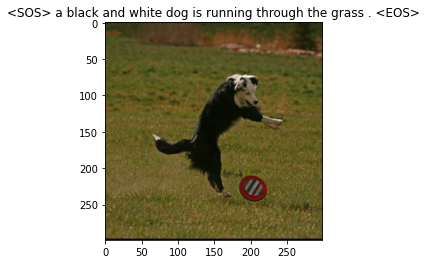

Actual caption = ['<SOS>', 'a', 'black', 'and', 'white', 'dog', 'jumps', 'in', 'the', 'air', 'near', 'a', 'red', 'frisbee', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'black', 'and', 'white', 'dog', 'is', 'running', 'through', 'the', 'grass', '.', '<EOS>']
0.8028097152709961
Epoch: 12 loss: 2.52248


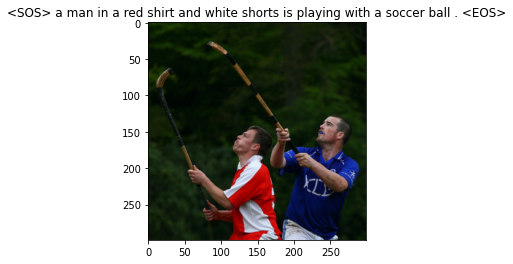

Actual caption = ['<SOS>', 'two', 'cricket', 'players', 'holding', 'their', 'sticks', 'in', 'the', 'air', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'and', 'white', 'shorts', 'is', 'playing', 'with', 'a', 'soccer', 'ball', '.', '<EOS>']
0.5592598915100098
Epoch: 12 loss: 2.33953


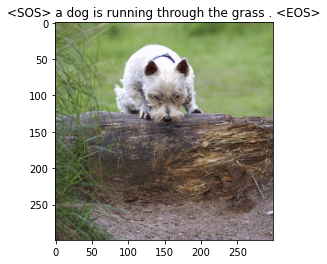

Actual caption = ['<SOS>', 'a', 'white', 'dog', 'jumps', 'over', 'a', 'log', 'outside', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'the', 'grass', '.', '<EOS>']
0.800715446472168
Epoch: 12 loss: 2.35884


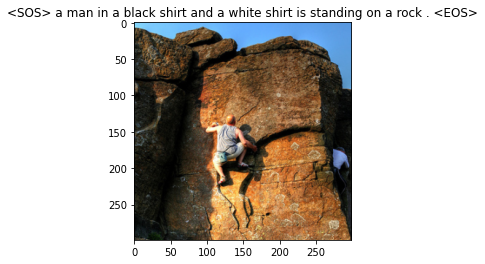

Actual caption = ['<SOS>', 'the', 'man', 'is', 'scaling', 'a', 'large', '<UNK>', 'boulder', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'a', 'white', 'shirt', 'is', 'standing', 'on', 'a', 'rock', '.', '<EOS>']
0.650891125202179
Epoch: 12 loss: 2.33794


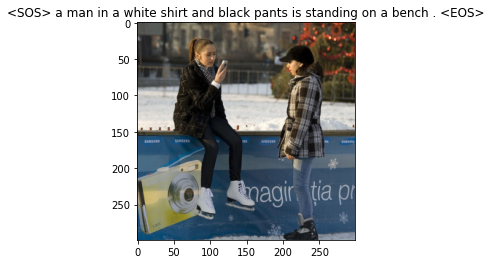

Actual caption = ['<SOS>', 'two', 'girls', 'are', 'ice', 'skating', 'and', 'one', 'is', 'checking', 'her', 'cellphone', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'white', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'on', 'a', 'bench', '.', '<EOS>']
0.7321217656135559
Epoch: 12 loss: 2.29938


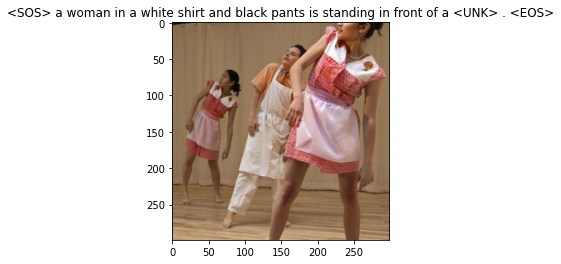

Actual caption = ['<SOS>', 'two', 'girls', 'dressed', 'like', '<UNK>', 'dance', 'along', 'with', 'a', 'man', 'dressed', 'as', 'a', '<UNK>', '.', '<EOS>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'woman', 'in', 'a', 'white', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.46652209758758545
End Epoch: 12   Hour: 4  Minutes : 10
*****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

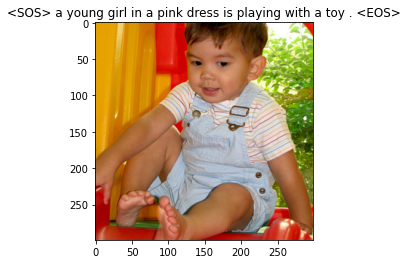

Actual caption = ['<SOS>', 'a', 'small', 'child', 'wearing', 'light', 'blue', 'overalls', 'sits', 'on', 'a', 'red', 'slide', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'playing', 'with', 'a', 'toy', '.', '<EOS>']
0.660632848739624
Epoch: 13 loss: 2.09363


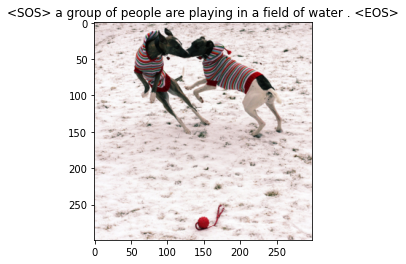

Actual caption = ['<SOS>', 'two', 'dogs', 'in', 'striped', 'sweaters', 'play', 'in', 'the', 'snow', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'playing', 'in', 'a', 'field', 'of', 'water', '.', '<EOS>']
0.6389431357383728
Epoch: 13 loss: 2.35696


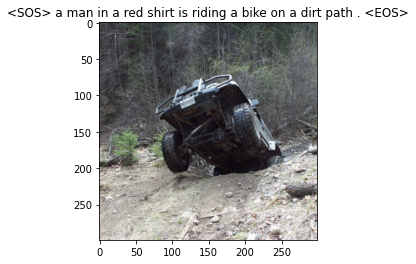

Actual caption = ['<SOS>', 'a', 'vehicle', 'comes', 'over', 'the', 'top', 'of', 'a', 'hill', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'riding', 'a', 'bike', 'on', 'a', 'dirt', 'path', '.', '<EOS>']
0.6687402725219727
Epoch: 13 loss: 2.41566


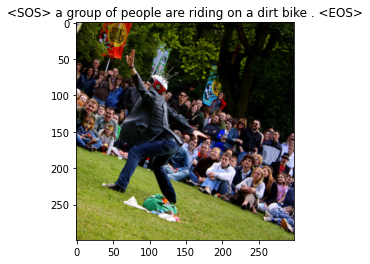

Actual caption = ['<SOS>', 'a', 'guy', 'in', 'a', 'costume', ',', 'a', 'crowd', 'watching', 'him', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'riding', 'on', 'a', 'dirt', 'bike', '.', '<EOS>']
0.7283252477645874
Epoch: 13 loss: 2.53872


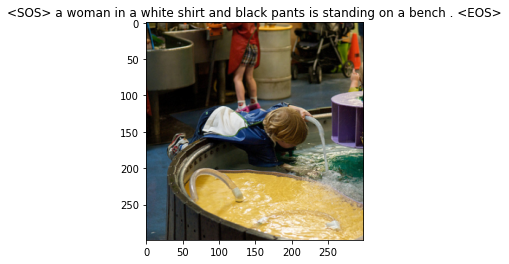

Actual caption = ['<SOS>', 'a', 'child', 'playing', 'with', 'water', 'in', 'a', 'children', "'s", '<UNK>', 'museum', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'woman', 'in', 'a', 'white', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'on', 'a', 'bench', '.', '<EOS>']
0.645777702331543
Epoch: 13 loss: 2.50411


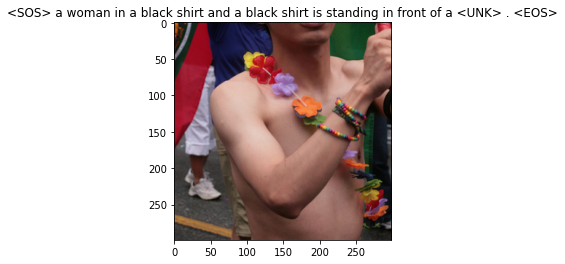

Actual caption = ['<SOS>', 'a', 'man', 'without', 'shirt', 'but', 'wearing', 'a', 'flower', 'necklace', 'is', 'holding', 'a', 'flag', 'pole', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'woman', 'in', 'a', 'black', 'shirt', 'and', 'a', 'black', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.4313894510269165
Epoch: 13 loss: 2.26275


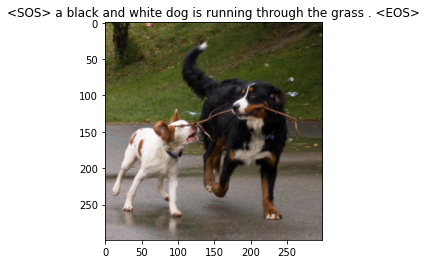

Actual caption = ['<SOS>', 'two', 'dogs', 'run', 'for', 'a', 'stick', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'black', 'and', 'white', 'dog', 'is', 'running', 'through', 'the', 'grass', '.', '<EOS>']
0.7521206140518188
Epoch: 13 loss: 2.22838


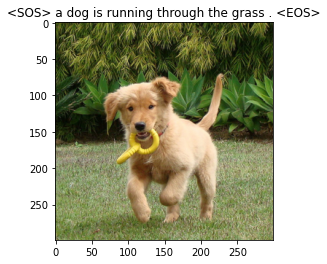

Actual caption = ['<SOS>', 'a', 'cute', 'puppy', 'fetches', 'a', 'yellow', 'ring', 'chew', 'toy', 'in', 'the', 'yard', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'the', 'grass', '.', '<EOS>']
0.696628212928772
Epoch: 13 loss: 2.51365


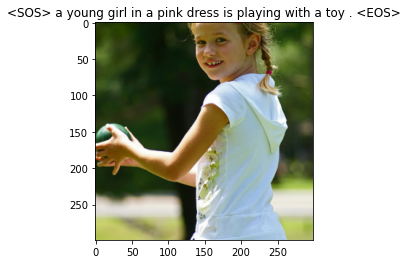

Actual caption = ['<SOS>', 'a', 'young', 'girl', 'wearing', 'white', 'looks', 'at', 'the', 'camera', 'as', 'she', 'plays', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'playing', 'with', 'a', 'toy', '.', '<EOS>']
0.742749810218811
End Epoch: 13   Hour: 4  Minutes : 34
****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

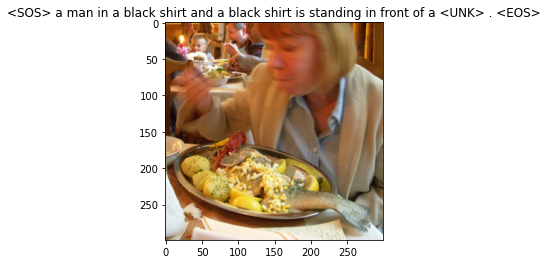

Actual caption = ['<SOS>', 'a', 'blond', 'woman', 'is', 'eating', 'in', 'a', 'busy', 'restaurant', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'a', 'black', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.546091616153717
Epoch: 14 loss: 2.44171


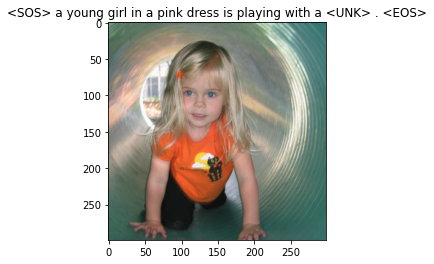

Actual caption = ['<SOS>', 'the', 'beautiful', 'young', 'girl', 'goes', 'through', 'the', 'tube', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'playing', 'with', 'a', '<UNK>', '.', '<EOS>']
0.660632848739624
Epoch: 14 loss: 2.27577


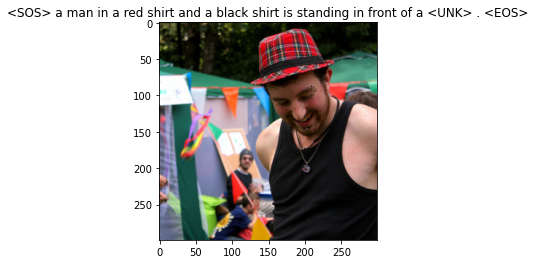

Actual caption = ['<SOS>', 'a', 'guy', 'with', 'a', 'black', 'tank', 'top', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'and', 'a', 'black', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.45499417185783386
Epoch: 14 loss: 2.26074


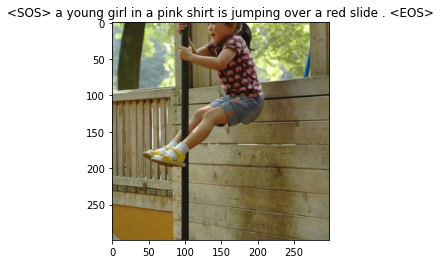

Actual caption = ['<SOS>', 'a', 'girl', 'sliding', 'down', 'a', 'pole', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'jumping', 'over', 'a', 'red', 'slide', '.', '<EOS>']
0.624575674533844
Epoch: 14 loss: 2.38272


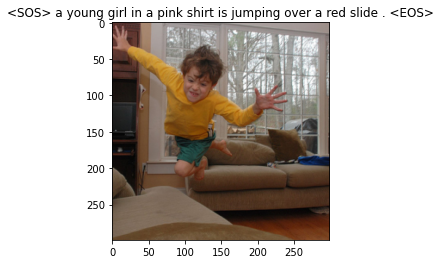

Actual caption = ['<SOS>', 'young', 'boy', 'wearing', 'a', 'yellow', 'shirt', 'jumps', 'onto', 'the', 'brown', 'couch', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'jumping', 'over', 'a', 'red', 'slide', '.', '<EOS>']
0.6147881746292114
Epoch: 14 loss: 2.68782


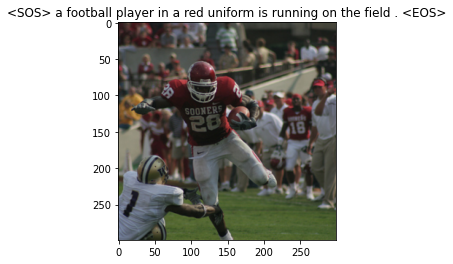

Actual caption = ['<SOS>', 'the', '<UNK>', 'football', 'player', 'carrying', 'the', 'ball', 'is', 'trying', 'to', '<UNK>', 'being', 'tackled', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'football', 'player', 'in', 'a', 'red', 'uniform', 'is', 'running', 'on', 'the', 'field', '.', '<EOS>']
0.6912065744400024
Epoch: 14 loss: 2.21809


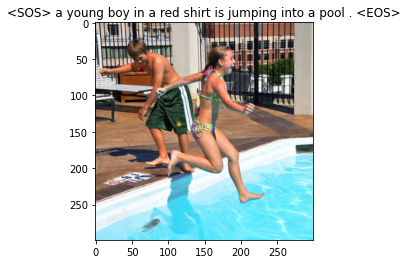

Actual caption = ['<SOS>', 'a', 'girl', 'with', 'a', 'boy', 'standing', '<UNK>', 'her', 'is', 'stepping', 'into', 'a', 'swimming', 'pool', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'boy', 'in', 'a', 'red', 'shirt', 'is', 'jumping', 'into', 'a', 'pool', '.', '<EOS>']
0.742913007736206
Epoch: 14 loss: 2.59857


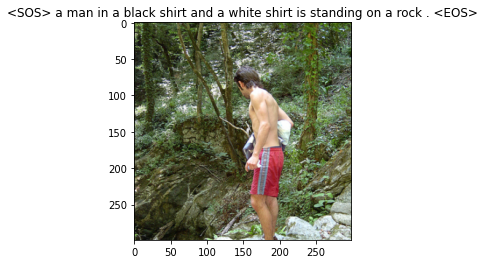

Actual caption = ['<SOS>', 'the', 'hiker', '<UNK>', 'a', 'creek', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'a', 'white', 'shirt', 'is', 'standing', 'on', 'a', 'rock', '.', '<EOS>']
0.6439548134803772
Epoch: 14 loss: 2.53303


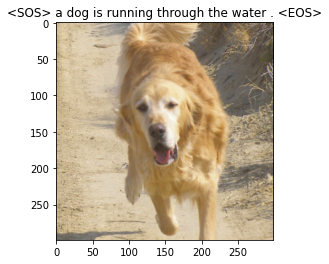

Actual caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'down', 'a', 'dirt', 'path', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'the', 'water', '.', '<EOS>']
0.9139916300773621
End Epoch: 14   Hour: 4  Minutes : 58
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

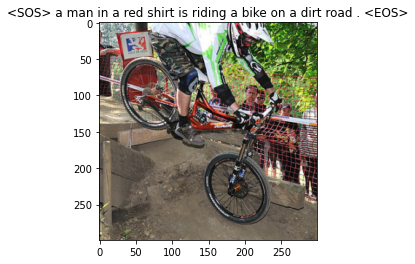

Actual caption = ['<SOS>', 'a', 'bicyclist', 'does', 'maneuvers', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'riding', 'a', 'bike', 'on', 'a', 'dirt', 'road', '.', '<EOS>']
0.5549740195274353
Epoch: 15 loss: 2.47560


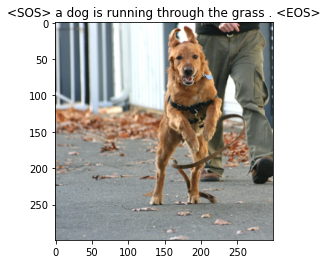

Actual caption = ['<SOS>', 'a', 'brown', 'dog', 'is', 'running', 'away', 'from', 'his', 'owner', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'the', 'grass', '.', '<EOS>']
0.836288571357727
Epoch: 15 loss: 2.33436


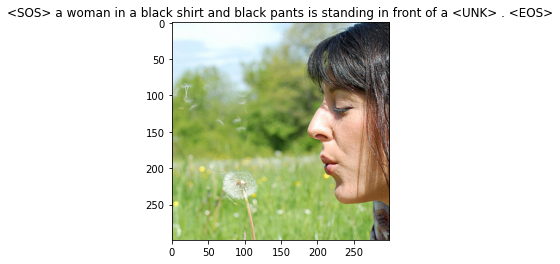

Actual caption = ['<SOS>', 'a', 'woman', 'blowing', 'on', 'a', 'dandelion', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'woman', 'in', 'a', 'black', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.655996561050415
Epoch: 15 loss: 2.27308


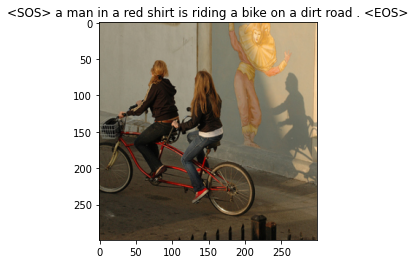

Actual caption = ['<SOS>', 'two', 'women', 'riding', 'a', '<UNK>', 'bicycle', 'go', 'by', 'a', 'wall', 'painting', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'riding', 'a', 'bike', 'on', 'a', 'dirt', 'road', '.', '<EOS>']
0.7098962068557739
Epoch: 15 loss: 2.27364


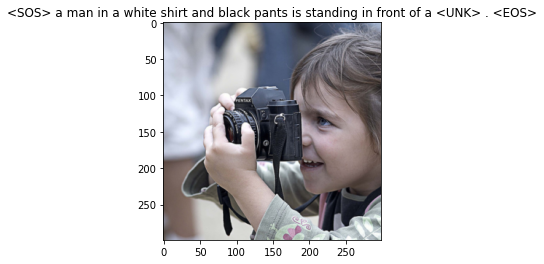

Actual caption = ['<SOS>', 'a', 'little', 'girl', 'holding', 'a', 'camera', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'white', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.4961682856082916
Epoch: 15 loss: 2.44429


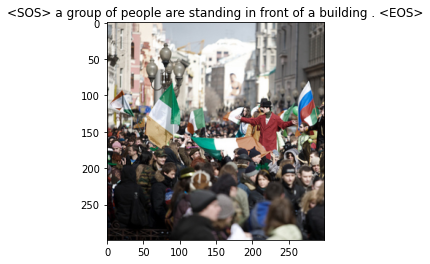

Actual caption = ['<SOS>', 'people', 'hold', 'flags', 'in', 'a', 'crowded', 'block', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'standing', 'in', 'front', 'of', 'a', 'building', '.', '<EOS>']
0.7484782934188843
Epoch: 15 loss: 2.22233


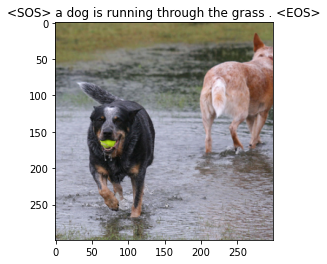

Actual caption = ['<SOS>', 'a', 'black', 'dog', 'crosses', 'a', 'puddle', 'of', 'water', 'with', 'a', 'ball', 'in', 'its', 'mouth', 'while', 'a', 'brown', 'dog', 'looks', 'the', 'other', 'way', '.', '<EOS>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'the', 'grass', '.', '<EOS>']
0.36860987544059753
Epoch: 15 loss: 2.23248


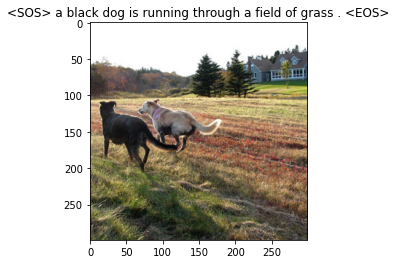

Actual caption = ['<SOS>', 'two', 'dogs', 'together', 'in', 'a', 'field', 'of', 'grass', 'within', '<UNK>', 'of', 'a', 'beautiful', 'home', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'black', 'dog', 'is', 'running', 'through', 'a', 'field', 'of', 'grass', '.', '<EOS>']
0.7096549272537231
Epoch: 15 loss: 2.22762


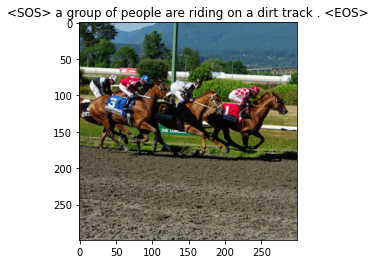

Actual caption = ['<SOS>', 'four', 'jockeys', 'and', 'their', 'horses', 'race', 'towards', 'the', 'finish', 'line', 'at', 'a', 'racetrack', '.', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'riding', 'on', 'a', 'dirt', 'track', '.', '<EOS>']
0.5555238127708435
End Epoch: 15   Hour: 5  Minutes : 22
**********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

In [19]:
num_epochs = 6
print_every = 100
# model.train()

for epoch in range(1,num_epochs+1):
    todays_date = datetime.now()
    print('Start Epoch: {}   Hour: {}  Minutes : {}'.format(epoch + epoch_no, todays_date.hour, todays_date.minute))      
    for idx, (image, captions) in enumerate(iter(data_loader)):
        image,captions = image.to(device),captions.to(device)

        # Zero the gradients.
        optimizer.zero_grad()

        # Feed forward
        outputs = model(image, captions)
        
        # Calculate the batch loss.
        loss = criterion(outputs.view(-1, vocab_size), captions.view(-1))

        
        # Backward pass.
        loss.backward()

        # Update the parameters in the optimizer.
        optimizer.step()
        
        if (idx+1)%print_every == 0:
            print("Epoch: {} loss: {:.5f}".format(epoch + epoch_no,loss.item()))
            
            
            #generate the caption
            model.eval()
            caption_needed =[]
            predicted_split_caps =[]
            with torch.no_grad():
                dataiter = iter(data_loader)
                img, ref_captions = next(dataiter)
                features = model.encoder(img[0:1].to(device))
                caps = model.decoder.generate_caption(features.unsqueeze(0),vocab=data_loader.dataset.vocab)
                caption = ' '.join(caps)
                show_image(img[0],title=caption)
                caption_needed = [data_loader.dataset.vocab.itos[idx] if idx in data_loader.dataset.vocab.itos else  data_loader.dataset.vocab.itos[3] for idx in ref_captions[0].detach().numpy()]
                print('Actual caption =', caption_needed)
                predicted_split_caps = caption.split(' ')
                print('Predicted caption =', caption.split(' '))
                len_diff = abs(len(caption_needed) - len(predicted_split_caps))
                list_pad = ['<PAD>'] * len_diff
                if len(caption_needed) > len(predicted_split_caps):
                  predicted_split_caps.extend(list_pad)
                else :
                  caption_needed.extend(list_pad)
            predicted_split_caps.insert(0, '<SOS>')
            caption_needed = [[caption_needed]]
            predicted_split_caps =[predicted_split_caps]
            print(bleu_score(predicted_split_caps, caption_needed, max_n=2, weights=[0.25, 0.25]))
                
            model.train()

    #save the latest model
    save_model(model, epoch + epoch_no, model.encoder, model.decoder)

    # Calculate the BLEU Score
    # calculate_bleu_score(data_loader)

    todays_date = datetime.now()
    print('End Epoch: {}   Hour: {}  Minutes : {}'.format(epoch + epoch_no, todays_date.hour, todays_date.minute))
    print('*' * 1000)

In [ ]:
len(data_loader.dataset.vocab)
total = 0
print('Trainable parameters:')
for name, param in model.named_parameters():
    # if param.requires_grad:
        print(name, '\t\t', param.numel())
        total += param.numel()
print('----------------------------------')
print('Total', '\t\t    ', total)

Trainable parameters:
encoder.resnet.0.conv.weight 		 9408
encoder.resnet.0.bn.weight 		 64
encoder.resnet.0.bn.bias 		 64
encoder.resnet.2.conv.weight 		 4096
encoder.resnet.2.bn.weight 		 64
encoder.resnet.2.bn.bias 		 64
encoder.resnet.3.conv.weight 		 110592
encoder.resnet.3.bn.weight 		 192
encoder.resnet.3.bn.bias 		 192
encoder.resnet.5.branch1.conv.weight 		 12288
encoder.resnet.5.branch1.bn.weight 		 64
encoder.resnet.5.branch1.bn.bias 		 64
encoder.resnet.5.branch2.0.conv.weight 		 18432
encoder.resnet.5.branch2.0.bn.weight 		 96
encoder.resnet.5.branch2.0.bn.bias 		 96
encoder.resnet.5.branch2.1.conv.weight 		 110592
encoder.resnet.5.branch2.1.bn.weight 		 128
encoder.resnet.5.branch2.1.bn.bias 		 128
encoder.resnet.5.branch3.0.conv.weight 		 3072
encoder.resnet.5.branch3.0.bn.weight 		 16
encoder.resnet.5.branch3.0.bn.bias 		 16
encoder.resnet.5.branch3.1.conv.weight 		 4608
encoder.resnet.5.branch3.1.bn.weight 		 32
encoder.resnet.5.branch3.1.bn.bias 		 32
encoder.resnet.5

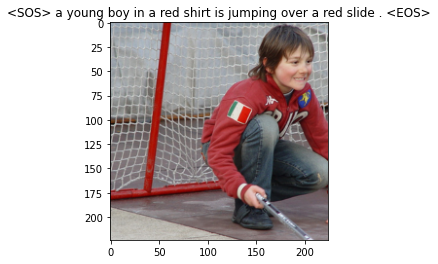

Actual caption = ['<SOS>', 'a', 'with', 'little', 'a', 'high', 'shop', 'girl', 'and', 'man', 'a', '<UNK>', 'all', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'boy', 'in', 'a', 'red', 'shirt', 'is', 'jumping', 'over', 'a', 'red', 'slide', '.', '<EOS>']
0.7784551978111267
************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

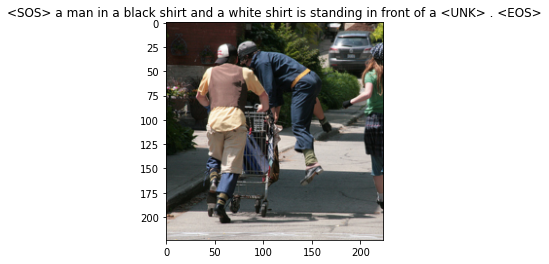

Actual caption = ['<SOS>', 'him', 'grass', 'group', 'child', '.', 'fountain', 'hat', 'green', 'to', 'doing', 'through', 'stroller', 'girl', 'a', 'bald', 'window', 'dog', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'a', 'white', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.6529942154884338
*************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

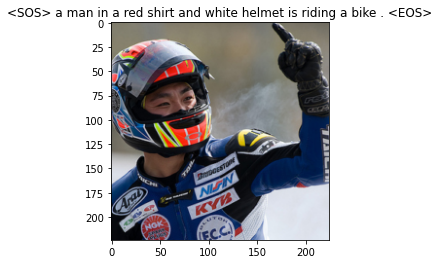

Actual caption = ['<SOS>', 'a', 'floating', 'leaps', 'fingers', 'pigtails', 'field', 'little', 'shirt', 'trees', 'sweater', 'girl', '.', 'snow', 'dog', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'and', 'white', 'helmet', 'is', 'riding', 'a', 'bike', '.', '<EOS>']
0.7222857475280762
**********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

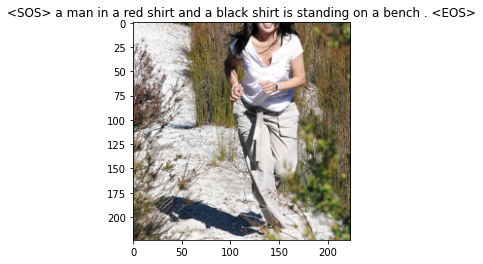

Actual caption = ['<SOS>', 'a', 'are', 'little', 'area', 'blue', 'jeans', 'hat', 'a', 'into', 'boy', 'to', 'beach', 'field', '.', 'nose', 'hat', 'look', '<UNK>', 'dog', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'and', 'a', 'black', 'shirt', 'is', 'standing', 'on', 'a', 'bench', '.', '<EOS>']
0.5863795280456543
*************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

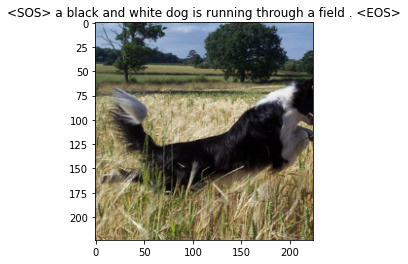

Actual caption = ['<SOS>', 'a', 'blue', 'hat', 'into', 'two', 'basketball', 'watches', 'look', '<UNK>', 'skier', 'dog', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'black', 'and', 'white', 'dog', 'is', 'running', 'through', 'a', 'field', '.', '<EOS>']
0.7984582781791687
************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

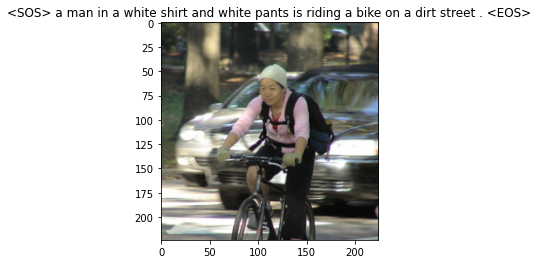

Actual caption = ['<SOS>', 'a', 'are', 'to', 'posing', 'walks', 'bed', 'child', '.', 'fountain', 'dog', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'white', 'shirt', 'and', 'white', 'pants', 'is', 'riding', 'a', 'bike', 'on', 'a', 'dirt', 'street', '.', '<EOS>']
0.6786502599716187
*******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

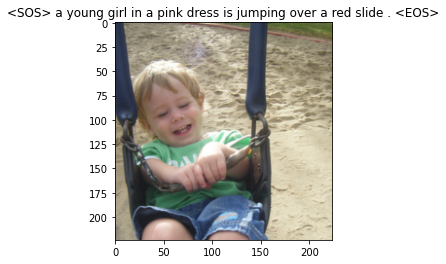

Actual caption = ['<SOS>', 'a', 'near', 'wall', 'pink', 'next', 'bench', 'a', 'baseball', 'on', 'a', 'frozen', 'dog', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'jumping', 'over', 'a', 'red', 'slide', '.', '<EOS>']
0.7793846726417542
***************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

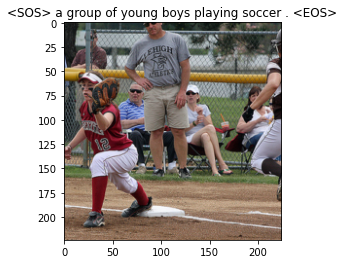

Actual caption = ['<SOS>', 'a', 'sitting', 'past', '<UNK>', 'through', 'cliff', 'a', 'swing', 'next', 'a', '<UNK>', 'goal', 'blowing', 'through', '.', 'flip', 'dog', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'young', 'boys', 'playing', 'soccer', '.', '<EOS>']
0.6325528621673584
***********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

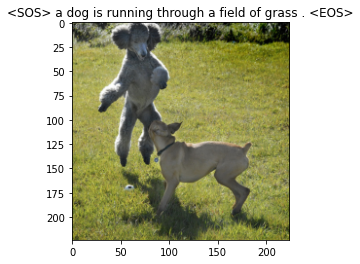

Actual caption = ['<SOS>', 'at', 'of', 'is', 'flying', 'by', 'mouth', 'girl', 'a', 'towards', 'dog', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'a', 'field', 'of', 'grass', '.', '<EOS>']
0.8114217519760132
**************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

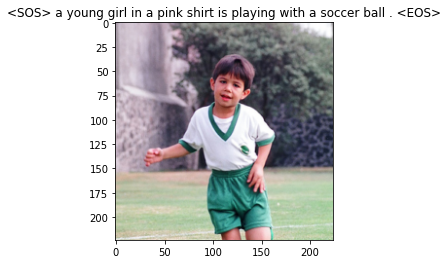

Actual caption = ['<SOS>', 'a', 'catch', 'with', 'building', 'a', 'person', 'climbs', '<UNK>', 'to', 'beach', 'bench', '.', 'skier', 'dog', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'playing', 'with', 'a', 'soccer', 'ball', '.', '<EOS>']
0.7326810359954834
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

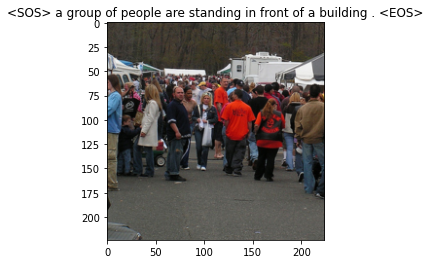

Actual caption = ['<SOS>', 'a', 'running', 'to', 'posing', 'a', '<UNK>', 'sheep', 'watches', 'a', 'store', 'hay', 'dog', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'standing', 'in', 'front', 'of', 'a', 'building', '.', '<EOS>']
0.7593673467636108
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

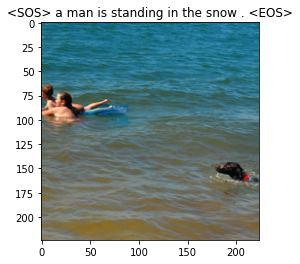

Actual caption = ['<SOS>', 'a', 'wall', 'spider', 'bench', 'a', 'stands', 'beer', 'next', 'a', 'are', 'road', 'bench', 'through', 'each', 'next', 'a', 'blue', 'two', 'skateboard', 'soccer', 'dog', '<EOS>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'is', 'standing', 'in', 'the', 'snow', '.', '<EOS>']
0.339808851480484
************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

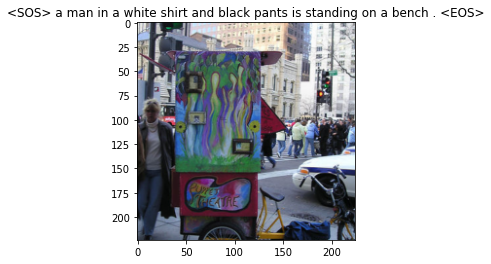

Actual caption = ['<SOS>', 'grass', 'bench', '.', 'runs', 'fountain', 'tunnel', 'both', 'a', '<UNK>', '<UNK>', 'dog', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'white', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'on', 'a', 'bench', '.', '<EOS>']
0.6973267197608948
*******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

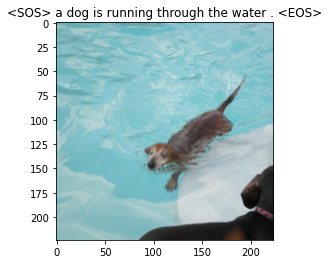

Actual caption = ['<SOS>', 'at', 'of', 'black', 'girl', 'a', 'red', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'the', 'water', '.', '<EOS>']
0.8633400201797485
*********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

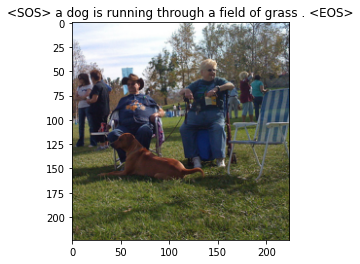

Actual caption = ['<SOS>', 'grass', 'pulling', 'girl', 'lone', 'on', 'a', 'ground', 'little', 'a', 'two', 'dog', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'a', 'field', 'of', 'grass', '.', '<EOS>']
0.8052365183830261
*****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

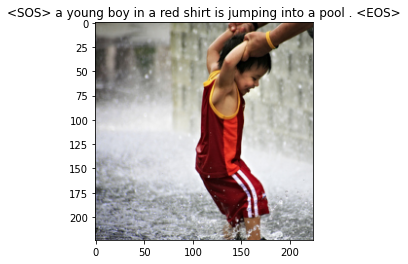

Actual caption = ['<SOS>', 'with', 'four', 'girl', 'playing', 'next', 'running', 'road', 'shirt', 'surrounded', 'dog', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'boy', 'in', 'a', 'red', 'shirt', 'is', 'jumping', 'into', 'a', 'pool', '.', '<EOS>']
0.7340407967567444
*********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

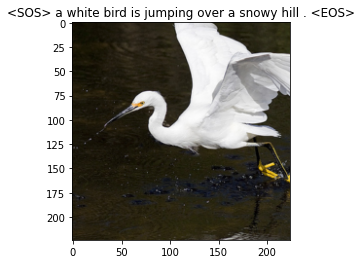

Actual caption = ['<SOS>', 'a', 'jacket', 'into', '<UNK>', 'haired', 'watches', '.', 'snow', 'rides', '.', 'white', 'dog', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'white', 'bird', 'is', 'jumping', 'over', 'a', 'snowy', 'hill', '.', '<EOS>']
0.794869601726532
********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

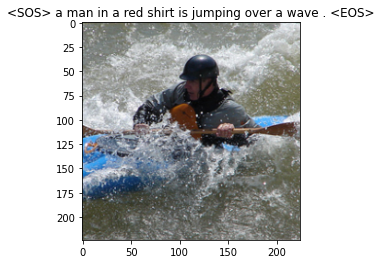

Actual caption = ['<SOS>', 'a', 'running', 'girl', 'a', 'stands', '"', '<UNK>', 'watches', 'kayaking', 'life', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'jumping', 'over', 'a', 'wave', '.', '<EOS>']
0.7856788039207458
*****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

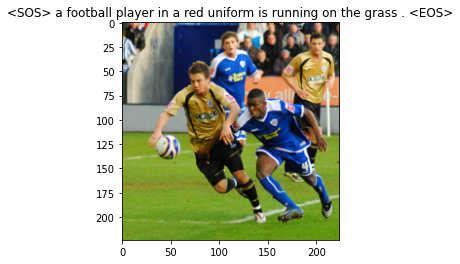

Actual caption = ['<SOS>', 'flowers', 'girl', 'stands', 'hat', 'into', 'back', 'hat', 'flowers', 'girl', '<UNK>', 'hat', 'blue', 'back', 'lying', 'does', 'climbs', 'water', 'dog', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'football', 'player', 'in', 'a', 'red', 'uniform', 'is', 'running', 'on', 'the', 'grass', '.', '<EOS>']
0.5602521300315857
*****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

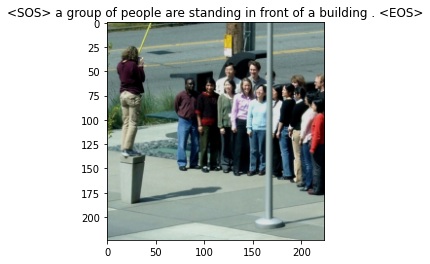

Actual caption = ['<SOS>', 'a', 'sitting', 'couple', 'bench', 'a', '<UNK>', 'clouds', 'a', 'front', 'shallow', 'dog', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'standing', 'in', 'front', 'of', 'a', 'building', '.', '<EOS>']
0.7598356604576111
*********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

In [23]:
# Testing on Validation set of Images
filename = "/content/drive/MyDrive/Visual Recognition/val_dataloader.p" # pratap
filehandler = open(filename, 'rb') 
data_loader_val = pickle.load(filehandler)
# model1 = torch.load('/content/drive/MyDrive/Visual Recognition/Models/WithoutAttentionModel_Resnet18_BS_32_trial.pth')

model.eval()
with torch.no_grad():
  for idx, (image, ref_captions) in enumerate(iter(data_loader_val)):
    caption_needed =[]
    predicted_split_caps =[]
    features = model.encoder(image[0:1].to(device))
    caps = model.decoder.generate_caption(features.unsqueeze(0), vocab=data_loader.dataset.vocab)
    caption = ' '.join(caps)
    show_image(image[0],title=caption)
    caption_needed = [data_loader.dataset.vocab.itos[idx] if idx in data_loader.dataset.vocab.itos else  data_loader.dataset.vocab.itos[3] for idx in ref_captions[0].detach().numpy()]
    print('Actual caption =', caption_needed)
    predicted_split_caps = caption.split(' ')
    print('Predicted caption =', caption.split(' '))
    len_diff = abs(len(caption_needed) - len(predicted_split_caps))
    list_pad = ['<PAD>'] * len_diff
    if len(caption_needed) > len(predicted_split_caps):
      predicted_split_caps.extend(list_pad)
    else :
      caption_needed.extend(list_pad)
    predicted_split_caps.insert(0, '<SOS>')
    caption_needed = [[caption_needed]]
    predicted_split_caps =[predicted_split_caps]
    print(bleu_score(predicted_split_caps, caption_needed, max_n=2, weights=[0.25, 0.25]))
    print('*' * 1000)

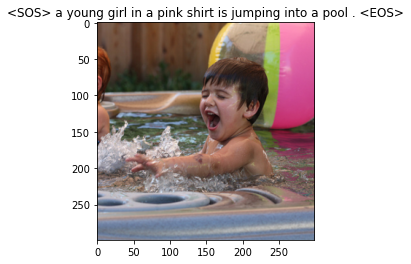

Actual caption = ['<SOS>', 'sitting', 'shirt', 'field', 'is', 'a', 'pole', 'and', 'a', 'catch', 'for', '<UNK>', 'bicycles', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'jumping', 'into', 'a', 'pool', '.', '<EOS>']
0.6828267574310303
**************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

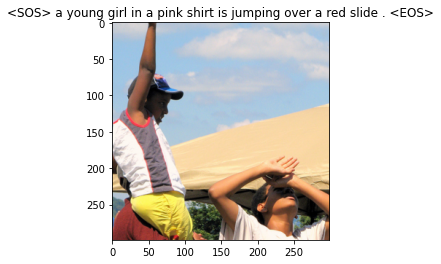

Actual caption = ['<SOS>', 'a', 'bench', 'suits', 'train', 'a', 'the', 'puppies', 'grass', 'store', 'helmet', 'dog', 'making', 'yellow', 'other', 'horse', 'bench', '<UNK>', 'by', 'grass', 'swinging', 'standing', 'dog', 'behind', 'in', '<EOS>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'jumping', 'over', 'a', 'red', 'slide', '.', '<EOS>']
0.29050809144973755
********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

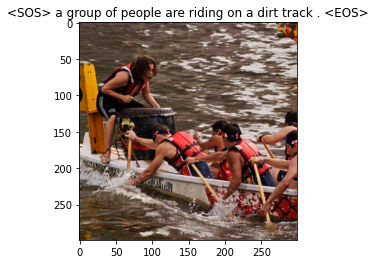

Actual caption = ['<SOS>', 'playing', 'is', 'net', '<UNK>', 'field', 'five', 'and', '<UNK>', '<UNK>', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'riding', 'on', 'a', 'dirt', 'track', '.', '<EOS>']
0.6650758385658264
*******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

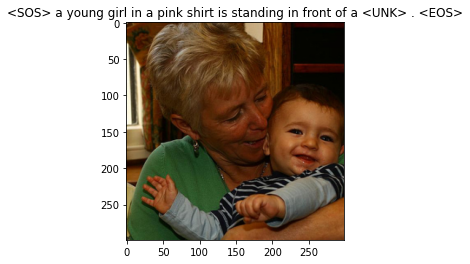

Actual caption = ['<SOS>', 'a', 'on', '.', 'is', 'a', 'boy', 'volleyball', 'mouth', 'a', 'small', 'ice', 'lays', 'a', 'small', 'bench', 'is', 'a', 'jacket', 'near', 'walks', 'little', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.5213732719421387
***********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

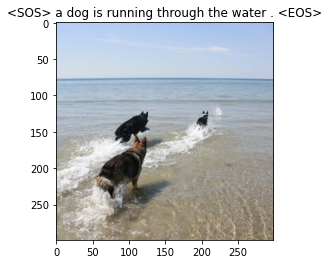

Actual caption = ['<SOS>', 'rock', 'people', '<UNK>', 'dog', 'jumps', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'the', 'water', '.', '<EOS>']
0.745887815952301
*****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

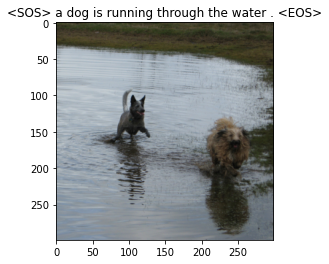

Actual caption = ['<SOS>', 'sitting', 'people', 'an', 'little', 'dog', 'park', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'the', 'water', '.', '<EOS>']
0.8260073661804199
****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

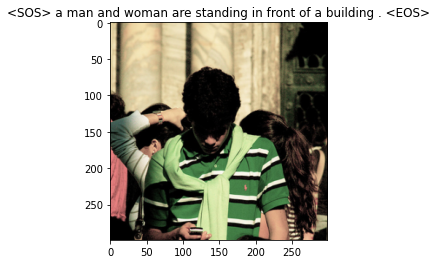

Actual caption = ['<SOS>', 'a', 'the', 'is', 'a', 'boy', 'near', 'of', 'volleyball', 'walks', 'at', 'grass', 'station', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'and', 'woman', 'are', 'standing', 'in', 'front', 'of', 'a', 'building', '.', '<EOS>']
0.7213563323020935
***************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

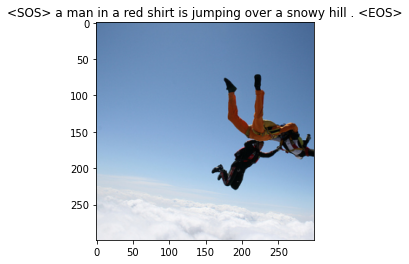

Actual caption = ['<SOS>', '<UNK>', 'black', '<UNK>', 'snow', 'swinging', 'is', 'making', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'jumping', 'over', 'a', 'snowy', 'hill', '.', '<EOS>']
0.6003124117851257
***********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

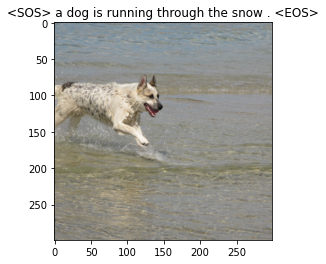

Actual caption = ['<SOS>', 'a', 'on', 'man', 'girl', 'orange', 'by', 'dog', 'young', 'at', 'a', 'catch', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'the', 'snow', '.', '<EOS>']
0.6551316976547241
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

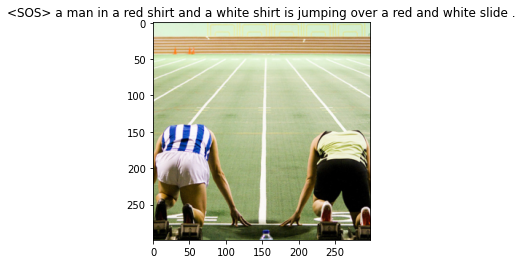

Actual caption = ['<SOS>', 'sitting', 'playing', 'field', 'is', 'orange', 'fish', '<UNK>', '<UNK>', 'and', 'a', 'back', '<UNK>', 'frozen', '<UNK>', 'black', 'shore', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'and', 'a', 'white', 'shirt', 'is', 'jumping', 'over', 'a', 'red', 'and', 'white', 'slide', '.']
0.5982315540313721
*************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

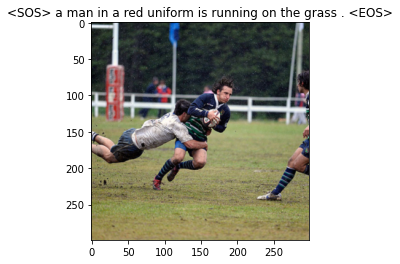

Actual caption = ['<SOS>', 'dog', 'the', 'and', 'dog', '<UNK>', 'for', 'girl', 'trees', 'scuba', 'train', 'horse', 'the', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'uniform', 'is', 'running', 'on', 'the', 'grass', '.', '<EOS>']
0.6645209193229675
***************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

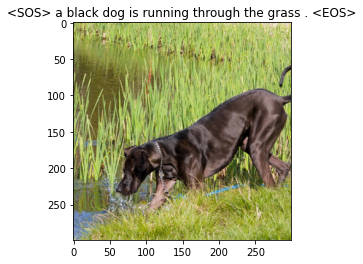

Actual caption = ['<SOS>', 'a', 'man', 'little', 'dog', 'ear', 'black', 'a', 'tree', 'black', 'young', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'black', 'dog', 'is', 'running', 'through', 'the', 'grass', '.', '<EOS>']
0.7521206140518188
*******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

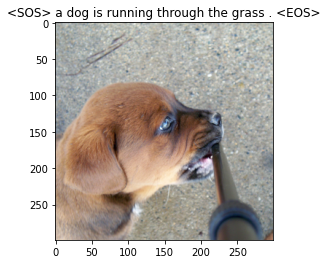

Actual caption = ['<SOS>', 'a', 'man', 'girl', '<UNK>', 'little', 'a', 'guitar', 'outdoors', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'the', 'grass', '.', '<EOS>']
0.7709458470344543
*****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

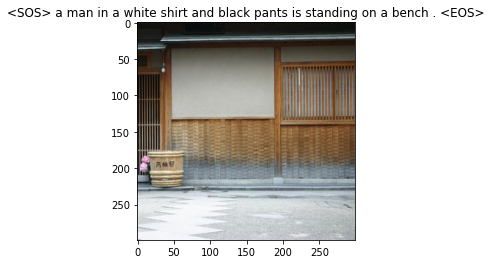

Actual caption = ['<SOS>', 'a', '<UNK>', '.', 'is', 'a', 'drink', 'structure', 'girl', 'lab', 'and', 'a', 'the', 'cliff', 'is', 'front', 'snowball', 'a', 'sandy', 'onto', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'white', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'on', 'a', 'bench', '.', '<EOS>']
0.5773502588272095
**************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

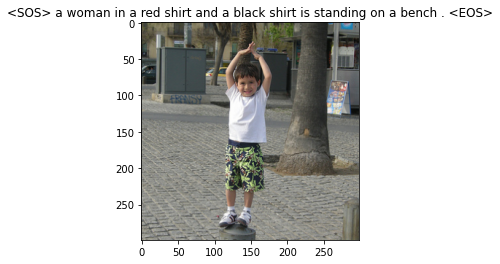

Actual caption = ['<SOS>', 'a', 'to', 'bench', 'high', 'little', 'a', 'steep', '<UNK>', 'is', 'a', 'smiling', 'and', 'grass', 'swinging', 'little', 'grass', 'sits', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'woman', 'in', 'a', 'red', 'shirt', 'and', 'a', 'black', 'shirt', 'is', 'standing', 'on', 'a', 'bench', '.', '<EOS>']
0.7013339996337891
*********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

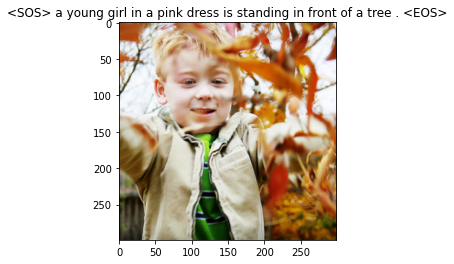

Actual caption = ['<SOS>', 'a', 'bench', 'colors', 'men', 'of', 'net', 'ocean', 'standing', 'dog', 'behind', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'standing', 'in', 'front', 'of', 'a', 'tree', '.', '<EOS>']
0.5410822629928589
************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

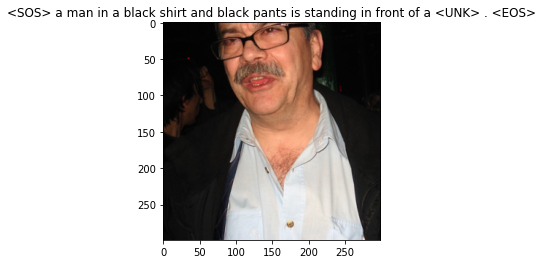

Actual caption = ['<SOS>', 'toy', 'taking', 'the', 'and', 'night', 'girl', 'each', ',', 'plays', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.45135390758514404
***************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

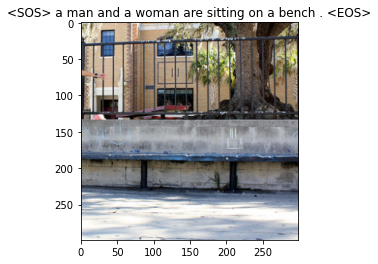

Actual caption = ['<SOS>', 'dog', 'bench', 'girl', 'left', 'little', 'dog', 'ledge', 'train', 'dog', 'different', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'and', 'a', 'woman', 'are', 'sitting', 'on', 'a', 'bench', '.', '<EOS>']
0.660632848739624
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

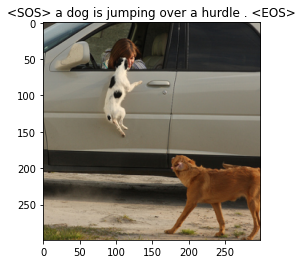

Actual caption = ['<SOS>', 'on', 'of', 'front', 'man', 'fight', 'at', 'toddler', 'by', 'as', 'duck', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'jumping', 'over', 'a', 'hurdle', '.', '<EOS>']
0.6450777053833008
*************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

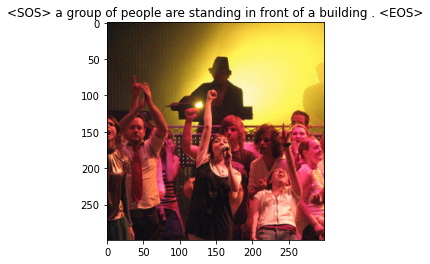

Actual caption = ['<SOS>', 'a', 'their', 'black', 'playing', '<UNK>', 'of', 'wakeboarding', 'at', 'a', '<UNK>', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'standing', 'in', 'front', 'of', 'a', 'building', '.', '<EOS>']
0.8106347918510437
************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

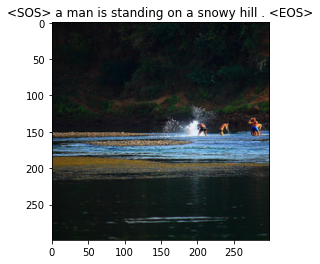

Actual caption = ['<SOS>', 'boats', 'shirt', 'horses', 'is', 'dog', 'young', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'is', 'standing', 'on', 'a', 'snowy', 'hill', '.', '<EOS>']
0.7283252477645874
*******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

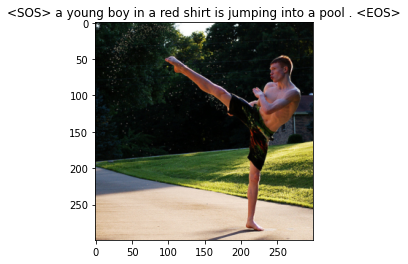

Actual caption = ['<SOS>', 'a', 'the', 'singing', 'a', 'harness', 'they', 'little', 'dog', 'steep', 'group', 'dog', 'next', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'boy', 'in', 'a', 'red', 'shirt', 'is', 'jumping', 'into', 'a', 'pool', '.', '<EOS>']
0.695015013217926
********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

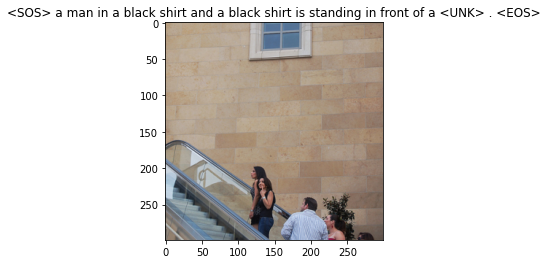

Actual caption = ['<SOS>', 'playing', '<UNK>', 'two', 'dog', '<UNK>', 'bike', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'a', 'black', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.39242589473724365
**************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

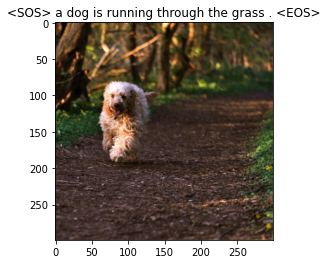

Actual caption = ['<SOS>', 'a', 'furry', 'man', 'laying', 'down', 'a', 'several', 'inflatable', 'is', 'a', '<UNK>', 'costumed', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'the', 'grass', '.', '<EOS>']
0.645777702331543
****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

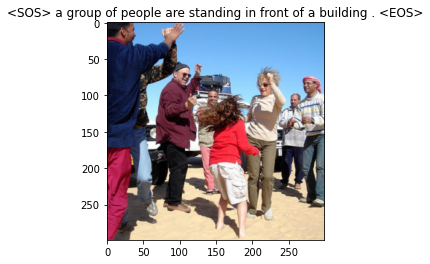

Actual caption = ['<SOS>', 'boats', 'playing', 'balcony', 'is', 'a', 'striped', '<UNK>', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'standing', 'in', 'front', 'of', 'a', 'building', '.', '<EOS>']
0.678518533706665
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

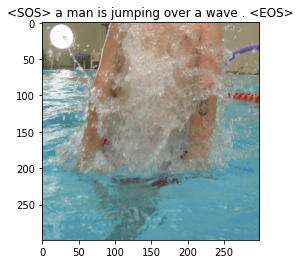

Actual caption = ['<SOS>', 'a', 'dogs', 'bench', 'girl', 'over', 'climbing', 'black', 'dog', 'pole', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'is', 'jumping', 'over', 'a', 'wave', '.', '<EOS>']
0.712104320526123
****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

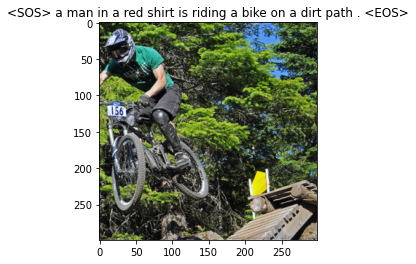

Actual caption = ['<SOS>', 'a', '<UNK>', 'are', 'a', '<UNK>', 'ground', 'down', 'a', 'snowy', 'sweater', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'riding', 'a', 'bike', 'on', 'a', 'dirt', 'path', '.', '<EOS>']
0.5868136286735535
**************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

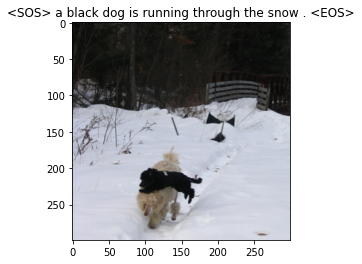

Actual caption = ['<SOS>', 'sitting', '<UNK>', 'field', 'orange', 'by', 'dog', 'looking', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'black', 'dog', 'is', 'running', 'through', 'the', 'snow', '.', '<EOS>']
0.7875110507011414
************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

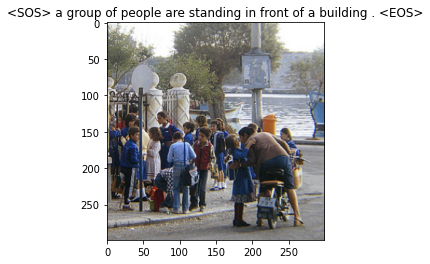

Actual caption = ['<SOS>', 'their', 'black', '<UNK>', 'is', 'splashing', 'looks', 'at', 'a', 'after', 'yellow', 'another', 'colored', 'overlooking', 'bald', '<UNK>', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'standing', 'in', 'front', 'of', 'a', 'building', '.', '<EOS>']
0.5014756321907043
*********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

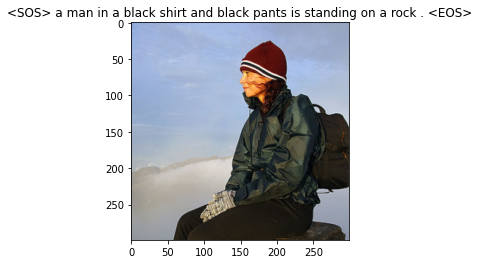

Actual caption = ['<SOS>', 'a', '.', 'is', 'a', '<UNK>', 'shirts', 'of', 'boy', 'grassy', 'with', 'little', 'a', 'feet', 'mouths', 'yellow', 'each', 'climbing', 'in', '<EOS>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'on', 'a', 'rock', '.', '<EOS>']
0.3715011775493622
**********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

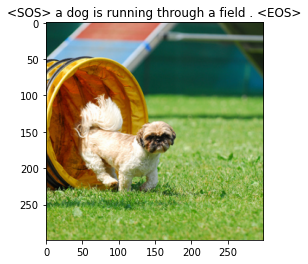

Actual caption = ['<SOS>', 'a', 'on', 'man', '<UNK>', 'while', 'a', 'jacket', 'lying', 'little', 'toy', 'go', 'cart', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'a', 'field', '.', '<EOS>']
0.5988059639930725
*********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

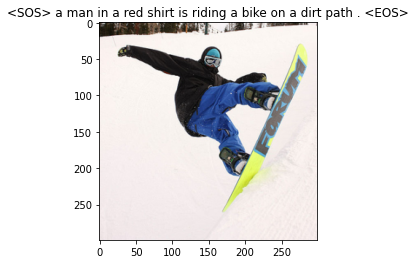

Actual caption = ['<SOS>', 'dog', 'hose', 'is', 'dog', 'child', 'peace', 'girl', 'low', 'a', 'very', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'riding', 'a', 'bike', 'on', 'a', 'dirt', 'path', '.', '<EOS>']
0.5880323648452759
************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

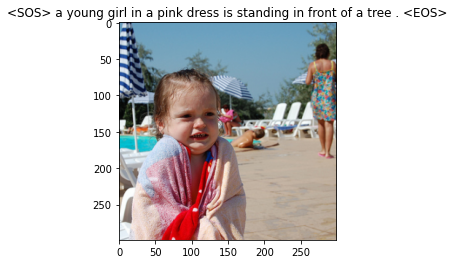

Actual caption = ['<SOS>', 'a', 'dogs', 'person', 'girl', 'around', 'is', 'a', 'wear', 'at', 'a', 'many', 'pole', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'standing', 'in', 'front', 'of', 'a', 'tree', '.', '<EOS>']
0.7393729090690613
****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

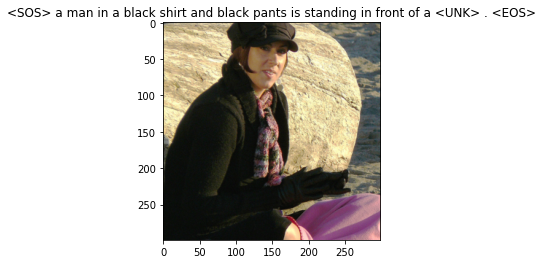

Actual caption = ['<SOS>', 'a', '.', 'is', 'a', 'front', 'shirts', 'of', 'structure', 'boys', 'is', 'dog', 'couple', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.5169731974601746
********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

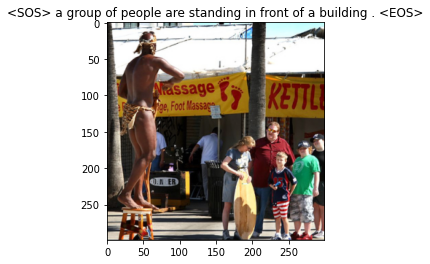

Actual caption = ['<SOS>', 'a', 'fluffy', 'black', 'art', 'girl', 'tongue', 'a', '<UNK>', 'looks', 'little', 'a', '<UNK>', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'standing', 'in', 'front', 'of', 'a', 'building', '.', '<EOS>']
0.678518533706665
*****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

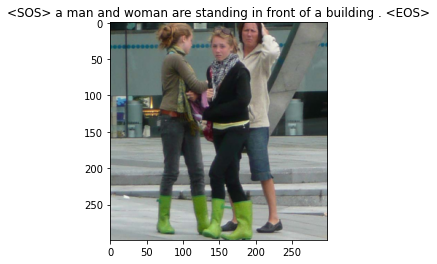

Actual caption = ['<SOS>', 'rock', 'pigtails', 'looks', 'little', 'a', 'woman', 'watches', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'and', 'woman', 'are', 'standing', 'in', 'front', 'of', 'a', 'building', '.', '<EOS>']
0.6912065744400024
*****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

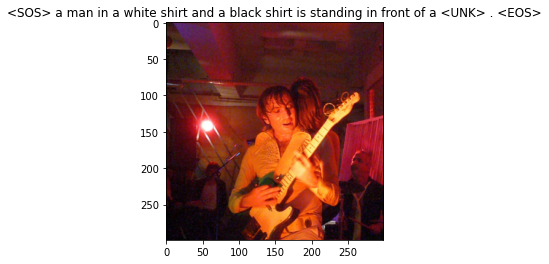

Actual caption = ['<SOS>', 'a', '.', 'mountain', 'jeep', 'train', 'a', 'wades', 'busy', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'white', 'shirt', 'and', 'a', 'black', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.46667569875717163
**********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

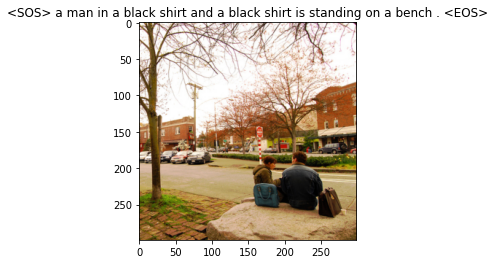

Actual caption = ['<SOS>', 'a', 'attached', 'field', 'brown', 'little', 'a', 'pool', 'is', 'skateboard', 'black', 'a', 'watches', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'a', 'black', 'shirt', 'is', 'standing', 'on', 'a', 'bench', '.', '<EOS>']
0.6554913520812988
*****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

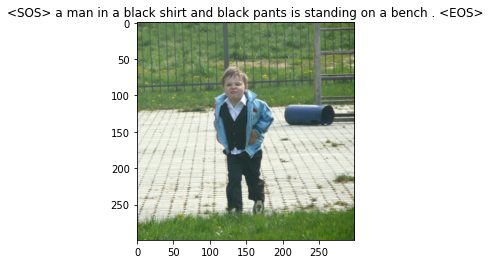

Actual caption = ['<SOS>', 'a', 'through', 'bench', 'are', 'a', 'busy', 'child', 'head', 'along', 'camera', 'dog', 'kayak', 'traffic', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'on', 'a', 'bench', '.', '<EOS>']
0.6452388763427734
***********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

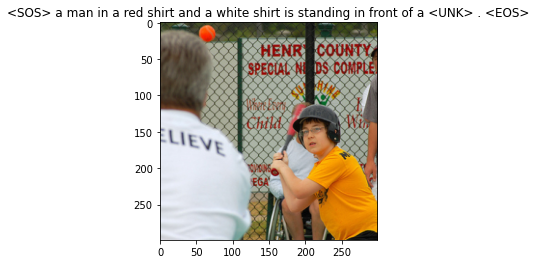

Actual caption = ['<SOS>', 'a', 'through', 'bench', 'girl', 'sign', 'sprinkler', 'white', 'scuba', 'a', 'sticking', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'and', 'a', 'white', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.3457207977771759
*********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

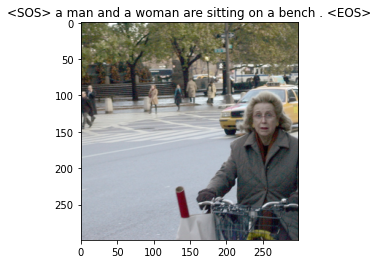

Actual caption = ['<SOS>', 'a', '.', 'is', 'a', 'dressed', '<UNK>', 'ring', 'overlooking', 'catches', 'bird', 'a', 'watches', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'and', 'a', 'woman', 'are', 'sitting', 'on', 'a', 'bench', '.', '<EOS>']
0.6529942154884338
***********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

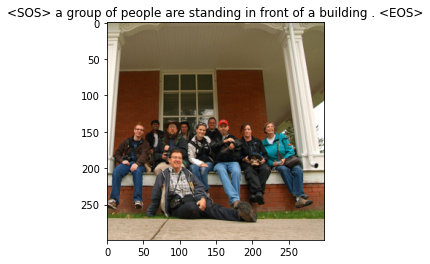

Actual caption = ['<SOS>', 'a', 'their', 'black', 'playing', 'field', 'brown', 'is', 'skateboard', 'black', 'a', 'men', 'kayak', 'of', 'on', '<UNK>', 'onto', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'standing', 'in', 'front', 'of', 'a', 'building', '.', '<EOS>']
0.575901448726654
*********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

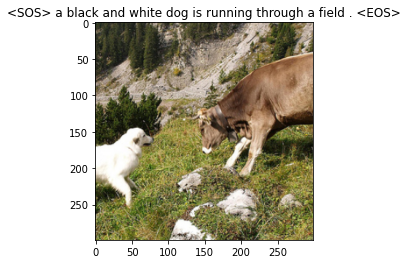

Actual caption = ['<SOS>', 'a', 'man', 'of', 'a', 'sleeping', 'field', 'little', 'a', 'purple', 'beige', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'black', 'and', 'white', 'dog', 'is', 'running', 'through', 'a', 'field', '.', '<EOS>']
0.7093914747238159
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

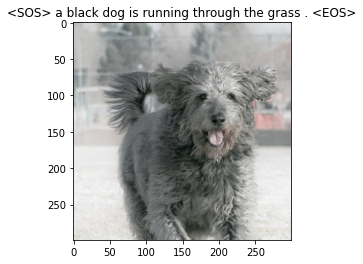

Actual caption = ['<SOS>', 'a', 'dressed', 'furry', 'man', 'orange', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'black', 'dog', 'is', 'running', 'through', 'the', 'grass', '.', '<EOS>']
0.7914194464683533
********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

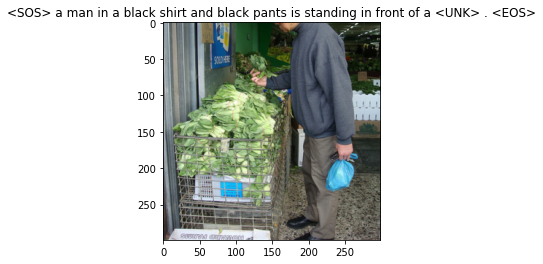

Actual caption = ['<SOS>', 'toy', 'taking', 'the', '<UNK>', '<UNK>', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.3303164541721344
**************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

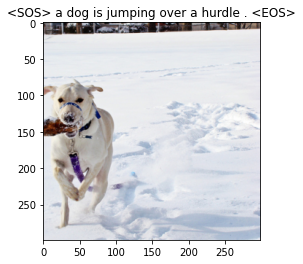

Actual caption = ['<SOS>', 'a', 'on', 'man', 'is', 'dog', 'looking', 'orange', 'and', 'toy', 'wet', 'is', 'with', 'up', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'jumping', 'over', 'a', 'hurdle', '.', '<EOS>']
0.678518533706665
*************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

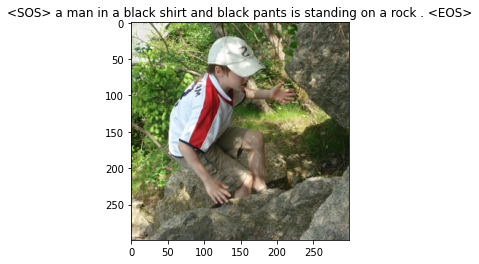

Actual caption = ['<SOS>', 'a', 'bench', 'motorcycle', 'two', 'four', 'blanket', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'on', 'a', 'rock', '.', '<EOS>']
0.5967462658882141
************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

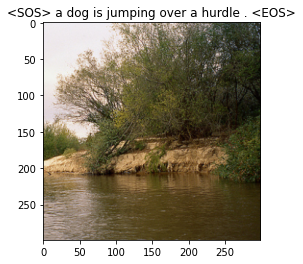

Actual caption = ['<SOS>', 'a', 'the', 'pond', 'a', 'flip', 'bird', 'dog', 'park', 'black', 'a', 'chalk', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'jumping', 'over', 'a', 'hurdle', '.', '<EOS>']
0.7096549272537231
***********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

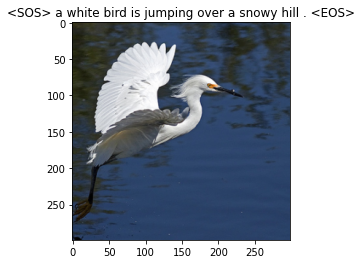

Actual caption = ['<SOS>', 'a', 'ball', 'on', 'racing', 'animal', 'one', 'young', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'white', 'bird', 'is', 'jumping', 'over', 'a', 'snowy', 'hill', '.', '<EOS>']
0.7550415396690369
*********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

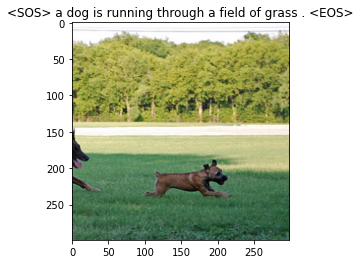

Actual caption = ['<SOS>', 'sitting', 'people', 'horses', 'is', 'dog', 'next', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'a', 'field', 'of', 'grass', '.', '<EOS>']
0.7093914747238159
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

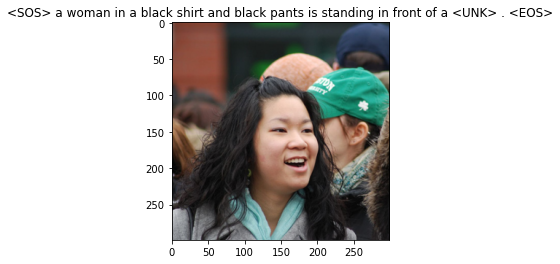

Actual caption = ['<SOS>', 'toy', 'blonde', 'bench', 'of', 'toy', 'blonde', 'person', 'field', 'small', 'is', 'a', 'posing', 'black', 'playing', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'woman', 'in', 'a', 'black', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.5313472151756287
**************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

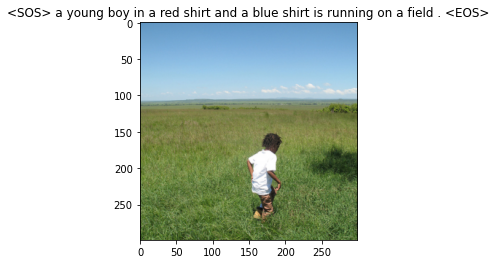

Actual caption = ['<SOS>', 'dog', 'ice', 'girl', 'lab', 'by', 'day', 'next', 'little', 'a', 'others', 'big', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'boy', 'in', 'a', 'red', 'shirt', 'and', 'a', 'blue', 'shirt', 'is', 'running', 'on', 'a', 'field', '.', '<EOS>']
0.5233175754547119
*********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

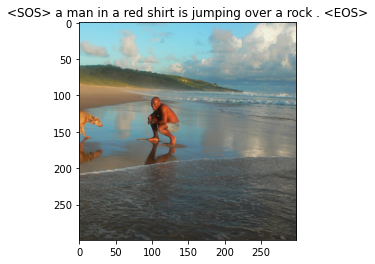

Actual caption = ['<SOS>', 'a', 'front', 'the', 'of', 'grass', 'man', 'little', 'dog', 'catch', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'jumping', 'over', 'a', 'rock', '.', '<EOS>']
0.826317310333252
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

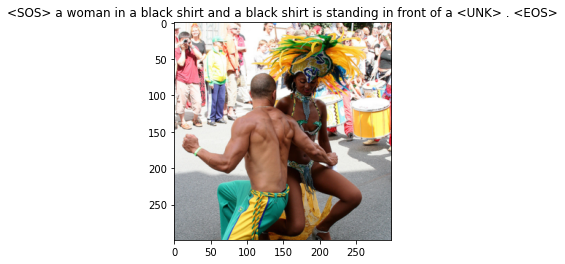

Actual caption = ['<SOS>', 'a', 'the', 'of', 'a', '.', 'are', '<UNK>', 'line', 'of', 'balcony', 'is', 'a', 'posing', 'black', 'uses', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'woman', 'in', 'a', 'black', 'shirt', 'and', 'a', 'black', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.5661913156509399
**************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

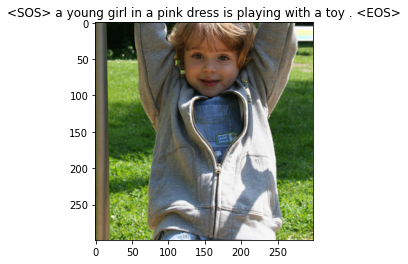

Actual caption = ['<SOS>', 'ice', 'is', 'dressed', 'inside', "'s", 'while', 'guitar', 'flag', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'playing', 'with', 'a', 'toy', '.', '<EOS>']
0.7232099771499634
************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

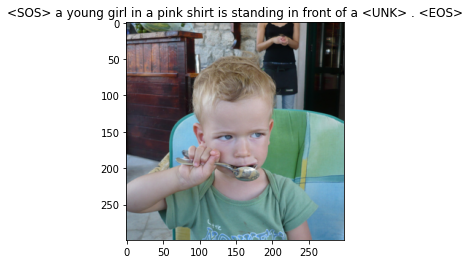

Actual caption = ['<SOS>', 'a', 'through', 'ice', 'mouth', 'a', 'wall', 'white', 'with', 'up', 'beach', 'brown', 'is', 'a', 'gate', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.6573046445846558
************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

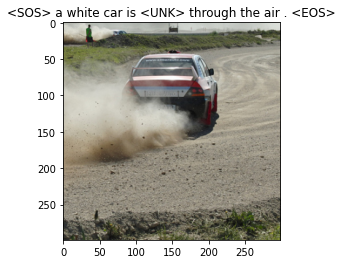

Actual caption = ['<SOS>', 'a', 'men', 'of', 'on', '<UNK>', 'as', 'colors', 'two', 'coloring', 'shirtless', 'pillow', 'other', 'mouse', 'beside', 'down', 'dog', 'inflatable', 'in', '<EOS>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'white', 'car', 'is', '<UNK>', 'through', 'the', 'air', '.', '<EOS>']
0.3835654854774475
*****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

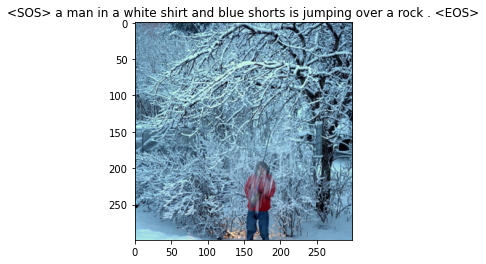

Actual caption = ['<SOS>', 'a', 'bench', 'is', 'a', 'men', 'head', '<UNK>', 'a', 'looking', 'around', 'frisbee', 'and', 'a', 'large', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'white', 'shirt', 'and', 'blue', 'shorts', 'is', 'jumping', 'over', 'a', 'rock', '.', '<EOS>']
0.6491151452064514
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

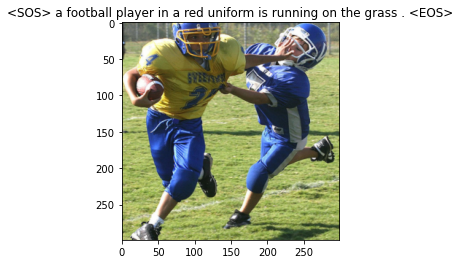

Actual caption = ['<SOS>', 'a', 'bench', 'is', 'a', 'jacket', 'attempting', 'skier', 'a', 'benches', 'girl', '<UNK>', 'horse', 'bench', 'is', 'a', 'child', 'attempting', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'football', 'player', 'in', 'a', 'red', 'uniform', 'is', 'running', 'on', 'the', 'grass', '.', '<EOS>']
0.5372849702835083
*********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

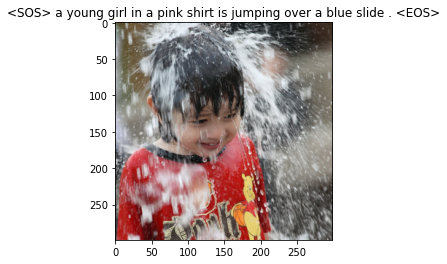

Actual caption = ['<SOS>', 'dog', 'dogs', 'bench', 'is', 'men', 'girl', 'sign', '<UNK>', 'and', 'young', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'jumping', 'over', 'a', 'blue', 'slide', '.', '<EOS>']
0.6371996998786926
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

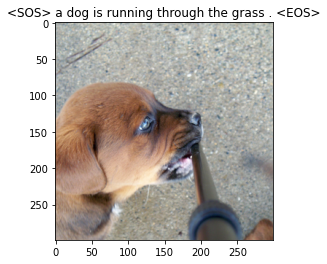

Actual caption = ['<SOS>', 'a', 'american', '<UNK>', 'a', 'outdoors', 'little', 'dog', 'climbs', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'the', 'grass', '.', '<EOS>']
0.7936087250709534
****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

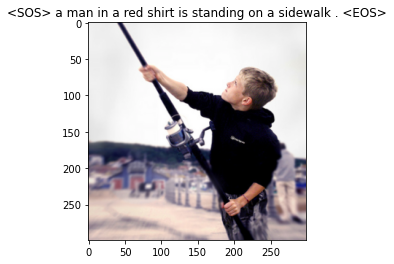

Actual caption = ['<SOS>', 'a', 'tan', 'bench', 'is', 'a', 'cap', 'right', 'girl', 'snow', 'a', 'leash', '<UNK>', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'standing', 'on', 'a', 'sidewalk', '.', '<EOS>']
0.6661926507949829
**************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

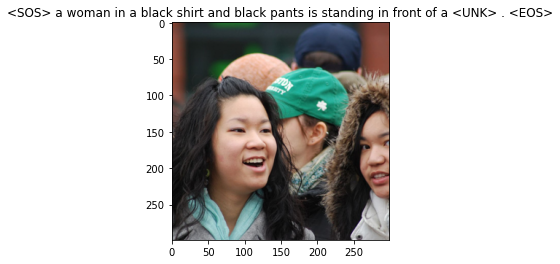

Actual caption = ['<SOS>', 'sitting', 'water', 'field', 'each', 'snowball', 'light', 'crowd', 'is', 'stuffed', '<UNK>', 'beach', 'looks', 'is', 'a', 'posing', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'woman', 'in', 'a', 'black', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.4806216359138489
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

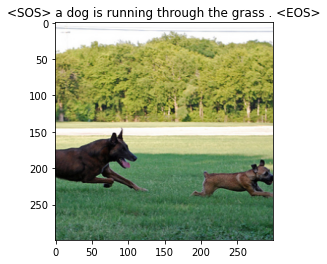

Actual caption = ['<SOS>', 'dog', 'ball', 'face', 'man', 'girl', 'race', 'tracks', 'dog', 'dogs', 'face', 'man', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'the', 'grass', '.', '<EOS>']
0.5988059639930725
***************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

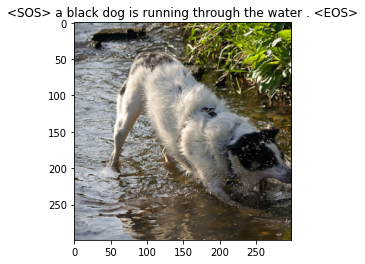

Actual caption = ['<SOS>', 'a', 'front', 'of', 'on', 'man', 'girl', 'an', 'is', 'a', 'get', 'hikers', 'drive', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'black', 'dog', 'is', 'running', 'through', 'the', 'water', '.', '<EOS>']
0.7357922792434692
*****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

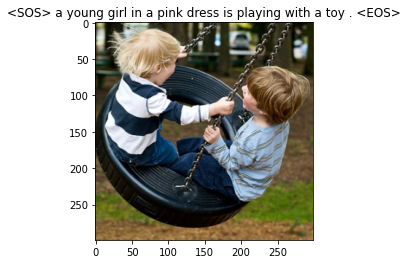

Actual caption = ['<SOS>', 'sitting', 'to', 'shirt', '<UNK>', 'an', 'little', 'a', 'board', 'off', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'playing', 'with', 'a', 'toy', '.', '<EOS>']
0.7536324262619019
*************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

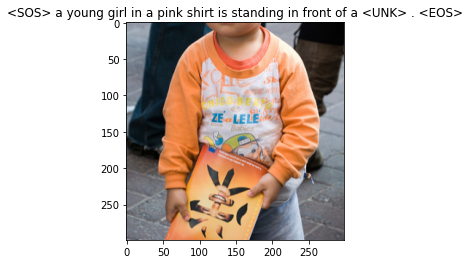

Actual caption = ['<SOS>', 'a', 'through', 'bench', 'girl', 'snow', 'a', 'lies', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.5735641717910767
***************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

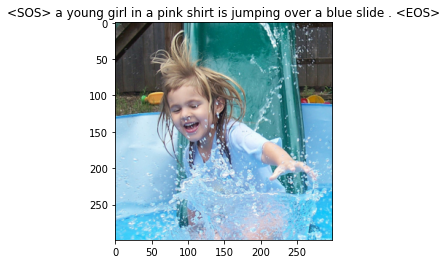

Actual caption = ['<SOS>', 'a', 'person', 'tennis', 'standing', 'a', 'pole', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'jumping', 'over', 'a', 'blue', 'slide', '.', '<EOS>']
0.6843777894973755
****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

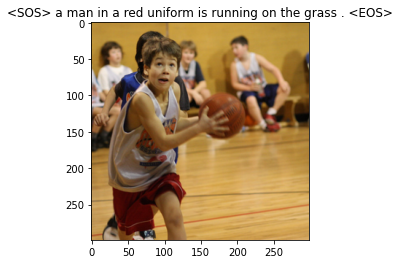

Actual caption = ['<SOS>', 'a', 'bench', 'and', 'men', 'outside', 'girl', 'snow', 'a', 'surrounded', 'is', 'a', 'surrounded', 'fighting', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'uniform', 'is', 'running', 'on', 'the', 'grass', '.', '<EOS>']
0.6588302850723267
*****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

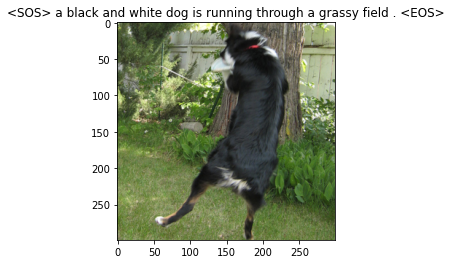

Actual caption = ['<SOS>', 'a', 'front', 'of', 'on', 'man', 'over', 'is', 'a', 'forest', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'black', 'and', 'white', 'dog', 'is', 'running', 'through', 'a', 'grassy', 'field', '.', '<EOS>']
0.7096549272537231
*********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

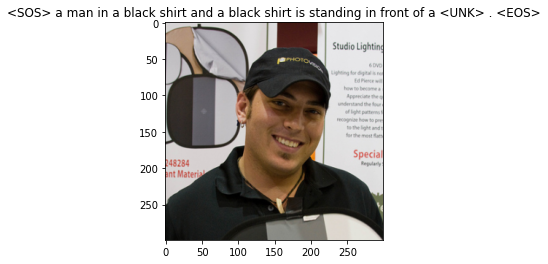

Actual caption = ['<SOS>', 'dog', 'the', 'girl', 'are', 'a', 'front', 'near', 'of', 'under', 'of', 'small', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'a', 'black', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.0
************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

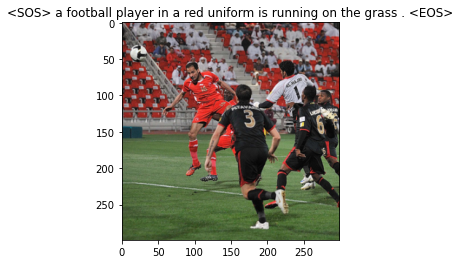

Actual caption = ['<SOS>', 'onlookers', 'air', 'swing', 'little', 'frozen', 'and', 'life', 'is', 'men', 'attempting', 'is', 'dog', 'behind', 'of', 'for', 'construction', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'football', 'player', 'in', 'a', 'red', 'uniform', 'is', 'running', 'on', 'the', 'grass', '.', '<EOS>']
0.4906849265098572
*********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

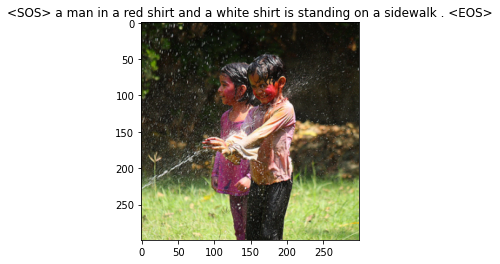

Actual caption = ['<SOS>', 'shirt', 'and', 'paddle', 'men', 'shop', 'trees', 'no', 'and', 'young', 'yellow', 'little', 'next', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'and', 'a', 'white', 'shirt', 'is', 'standing', 'on', 'a', 'sidewalk', '.', '<EOS>']
0.5741865634918213
*************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

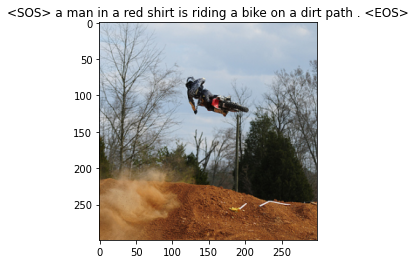

Actual caption = ['<SOS>', 'a', 'his', 'little', 'a', 'several', 'into', '<UNK>', 'by', 'dog', 'behind', '<UNK>', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'riding', 'a', 'bike', 'on', 'a', 'dirt', 'path', '.', '<EOS>']
0.4848516881465912
********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

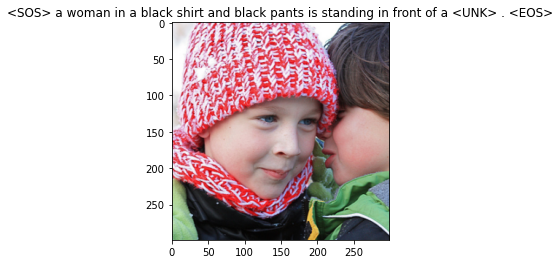

Actual caption = ['<SOS>', 'dog', 'ice', 'is', 'dog', 'men', 'of', 'on', 'under', 'girl', '<UNK>', 'white', 'dog', 'ice', 'and', 'dog', 'face', 'her', 'of', 'boy', 'head', 'in', '<EOS>']
Predicted caption = ['<SOS>', 'a', 'woman', 'in', 'a', 'black', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.0
********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

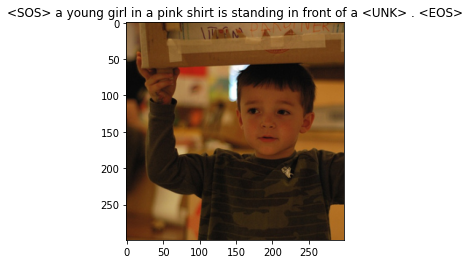

Actual caption = ['<SOS>', 'a', 'through', 'bench', 'and', 'a', '<UNK>', 'giant', 'safety', 'kicking', 'grass', 'sits', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.6645209193229675
*********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

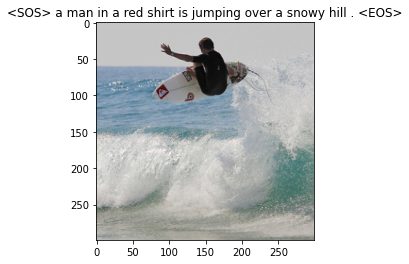

Actual caption = ['<SOS>', 'toy', 'chasing', 'construction', 'one', 'a', 'stone', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'jumping', 'over', 'a', 'snowy', 'hill', '.', '<EOS>']
0.645777702331543
*****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

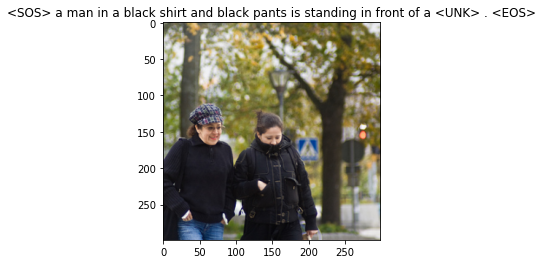

Actual caption = ['<SOS>', 'sitting', 'pigtails', 'lab', 'group', 'four', 'some', 'is', '<UNK>', 'yellow', 'cap', 'jumping', 'hot', '<UNK>', 'yellow', 'another', 'and', 'a', 'under', 'yellow', 'another', 'and', 'toy', '<UNK>', 'strollers', 'in', '<EOS>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.0
**************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

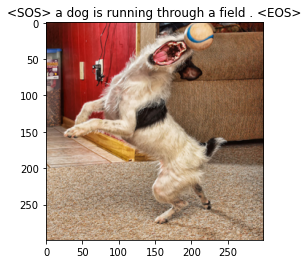

Actual caption = ['<SOS>', 'a', 'man', 'rapids', 'a', 'for', 'is', 'with', 'up', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'a', 'field', '.', '<EOS>']
0.7730551958084106
*************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

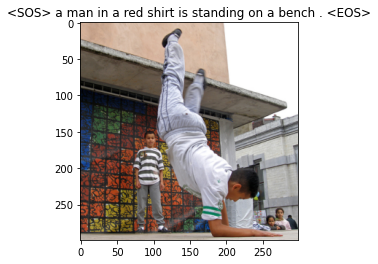

Actual caption = ['<SOS>', 'a', 'woman', 'shepherd', '<UNK>', '<UNK>', 'white', '<UNK>', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'standing', 'on', 'a', 'bench', '.', '<EOS>']
0.6389431357383728
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

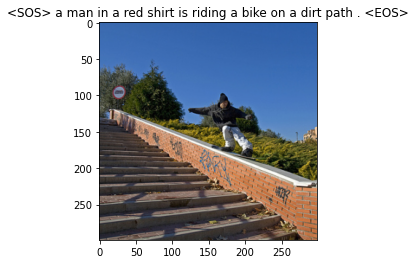

Actual caption = ['<SOS>', 'a', 'the', 'smile', 'down', 'a', 'snowy', 'picture', 'shorts', 'white', 'four', 't', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'riding', 'a', 'bike', 'on', 'a', 'dirt', 'path', '.', '<EOS>']
0.5868136286735535
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

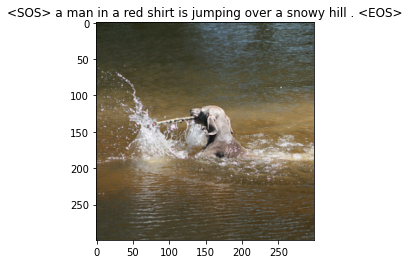

Actual caption = ['<SOS>', 'a', 'man', 'many', 'and', 'a', 'large', 'is', 'with', 'up', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'jumping', 'over', 'a', 'snowy', 'hill', '.', '<EOS>']
0.7484782934188843
*******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

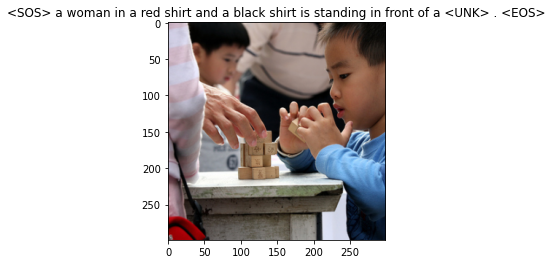

Actual caption = ['<SOS>', 'a', 'bench', 'mountain', 'a', 'play', 'and', 'sandy', 'flower', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'woman', 'in', 'a', 'red', 'shirt', 'and', 'a', 'black', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.3457207977771759
**********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

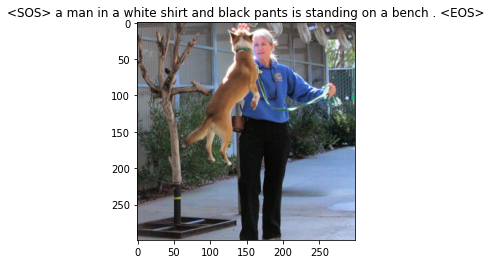

Actual caption = ['<SOS>', 'a', 'man', 'over', 'two', 'white', '<UNK>', 'a', '.', 'run', 'pants', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'white', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'on', 'a', 'bench', '.', '<EOS>']
0.6828267574310303
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

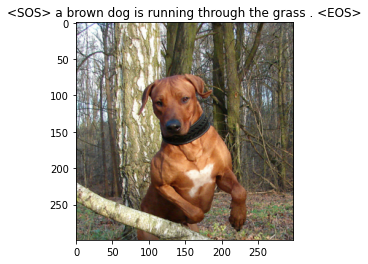

Actual caption = ['<SOS>', 'a', 'face', 'man', 'girl', 'over', 'one', 'a', 'frisbee', '<UNK>', 'is', 'a', 'like', 'scooter', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'brown', 'dog', 'is', 'running', 'through', 'the', 'grass', '.', '<EOS>']
0.6098694801330566
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

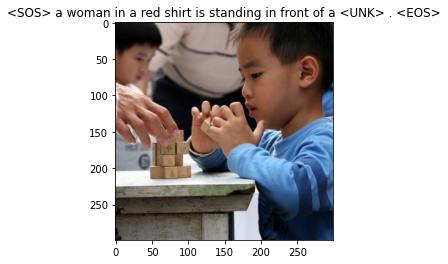

Actual caption = ['<SOS>', 'a', 'to', 'bench', 'girl', 'onto', 'and', 'four', 'sandy', 'flower', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'woman', 'in', 'a', 'red', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.6513555645942688
***********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

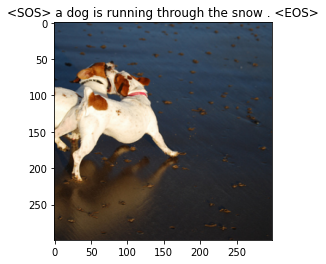

Actual caption = ['<SOS>', 'people', 'bucket', 'light', 'crowd', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'the', 'snow', '.', '<EOS>']
0.7816713452339172
*************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

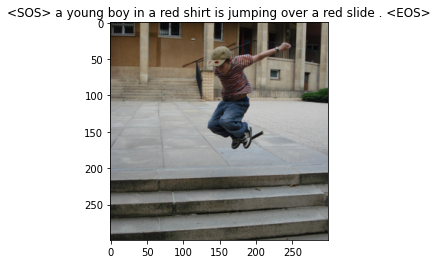

Actual caption = ['<SOS>', 'a', 'through', 'the', 'over', 'by', 'dog', 'behind', 'group', 'a', 'shallow', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'boy', 'in', 'a', 'red', 'shirt', 'is', 'jumping', 'over', 'a', 'red', 'slide', '.', '<EOS>']
0.5721248388290405
********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

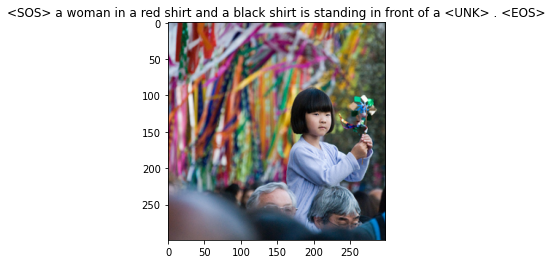

Actual caption = ['<SOS>', 'a', 'water', 'is', 'a', 'child', 'near', 'mouth', 'a', 'goes', 'beach', 'brown', 'little', 'a', 'the', 'run', 'both', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'woman', 'in', 'a', 'red', 'shirt', 'and', 'a', 'black', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.7044129967689514
*******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

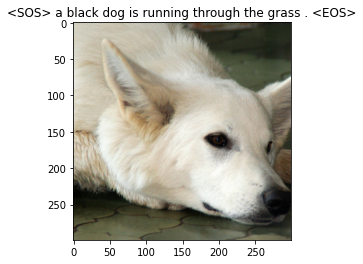

Actual caption = ['<SOS>', 'a', 'on', 'man', '<UNK>', 'with', 'sits', 'little', 'dog', 'traffic', '<UNK>', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'black', 'dog', 'is', 'running', 'through', 'the', 'grass', '.', '<EOS>']
0.6551316976547241
************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

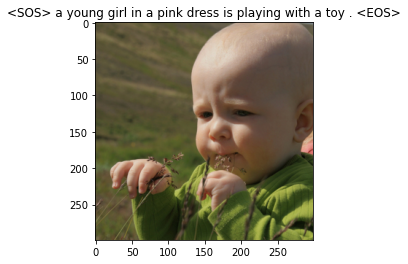

Actual caption = ['<SOS>', 'a', 'blue', '<UNK>', 'little', 'shoulder', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'playing', 'with', 'a', 'toy', '.', '<EOS>']
0.6976729035377502
***********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

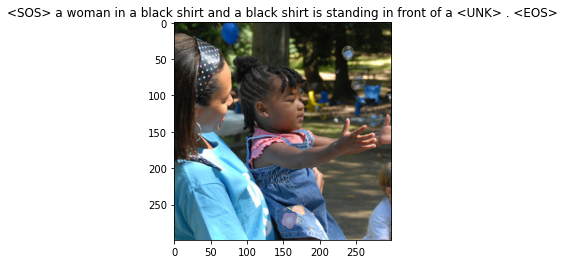

Actual caption = ['<SOS>', 'a', 'railing', 'mouth', 'a', 'dogs', 'person', 'hanging', 'girl', 'swings', 'white', 'rides', 'jungle', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'woman', 'in', 'a', 'black', 'shirt', 'and', 'a', 'black', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.4906849265098572
****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

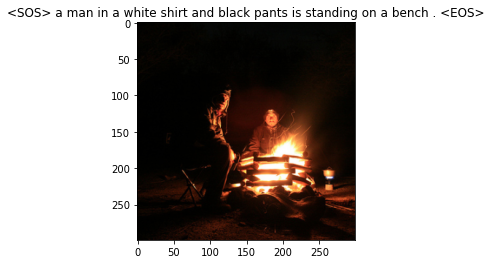

Actual caption = ['<SOS>', 'playing', 'green', 'group', 'a', 'rider', 'sit', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'white', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'on', 'a', 'bench', '.', '<EOS>']
0.472870796918869
*******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

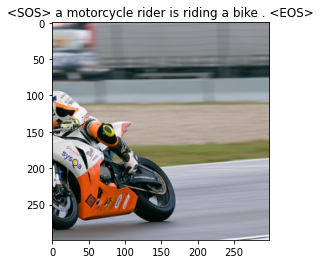

Actual caption = ['<SOS>', 'a', 'the', 'ground', 'toy', 'net', 'of', 'on', 'dirty', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'motorcycle', 'rider', 'is', 'riding', 'a', 'bike', '.', '<EOS>']
0.7816713452339172
****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

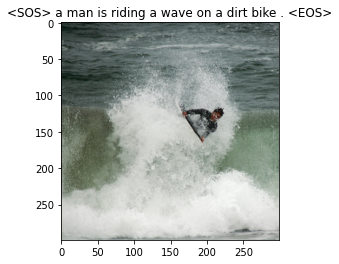

Actual caption = ['<SOS>', 'dog', 'chasing', 'rapids', 'a', 'flowers', 'stone', 'crawling', '<UNK>', 'little', 'grass', 'she', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'is', 'riding', 'a', 'wave', 'on', 'a', 'dirt', 'bike', '.', '<EOS>']
0.6822570562362671
*************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

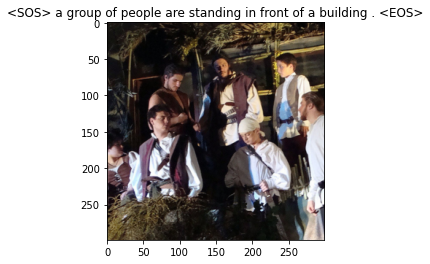

Actual caption = ['<SOS>', 'dog', '<UNK>', 'runs', 'field', 'wood', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'standing', 'in', 'front', 'of', 'a', 'building', '.', '<EOS>']
0.7115966081619263
*****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

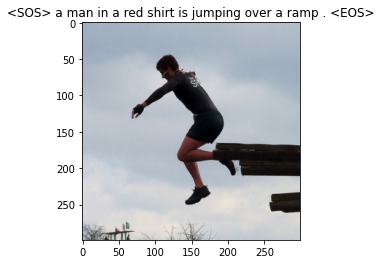

Actual caption = ['<SOS>', 'a', 'the', 'girl', 'pulls', ',', '<UNK>', 'beach', 'are', 'sidewalk', 'front', 'screen', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'jumping', 'over', 'a', 'ramp', '.', '<EOS>']
0.6389431357383728
**************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

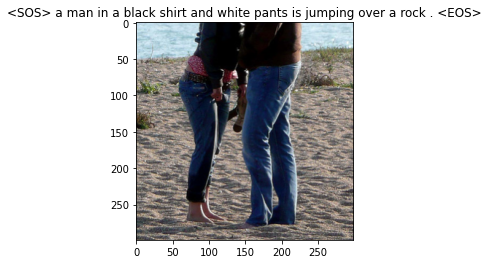

Actual caption = ['<SOS>', 'sitting', 'playing', 'beer', 'little', 'dog', 'catch', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'white', 'pants', 'is', 'jumping', 'over', 'a', 'rock', '.', '<EOS>']
0.4961682856082916
***************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

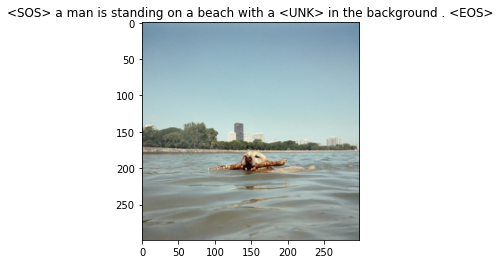

Actual caption = ['<SOS>', 'a', 'man', 'many', 'bird', 'dog', 'jumps', 'and', 'a', '<UNK>', 'is', 'with', 'up', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'is', 'standing', 'on', 'a', 'beach', 'with', 'a', '<UNK>', 'in', 'the', 'background', '.', '<EOS>']
0.7471754550933838
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

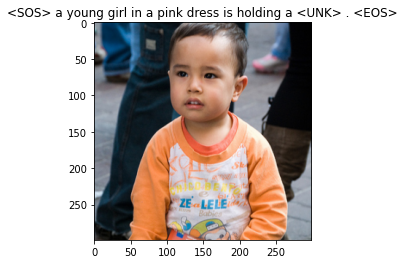

Actual caption = ['<SOS>', 'a', 'through', 'blonde', 'bench', 'is', 'a', 'net', 'back', 'jumping', 'party', 'sled', 'jumping', 'near', 'mouth', 'a', '<UNK>', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'holding', 'a', '<UNK>', '.', '<EOS>']
0.600963830947876
************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

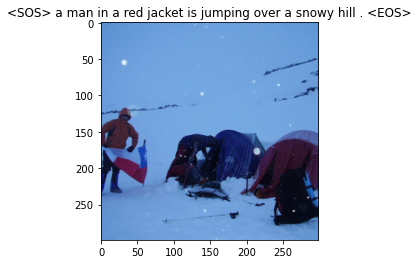

Actual caption = ['<SOS>', 'a', 'his', 'background', 'two', 'a', 'row', 'rocks', 'a', 'sliding', 'crowd', 'girls', 'little', 'dog', 'unicycle', 'climbs', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'jacket', 'is', 'jumping', 'over', 'a', 'snowy', 'hill', '.', '<EOS>']
0.6324555277824402
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

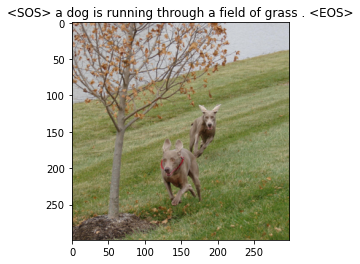

Actual caption = ['<SOS>', 'sitting', 'dressed', 'people', 'painting', 'group', 'dog', 'young', 'little', 'a', '<UNK>', 'someone', 'is', 'dog', 'clear', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'a', 'field', 'of', 'grass', '.', '<EOS>']
0.5283420085906982
****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

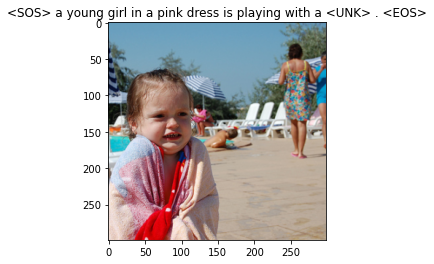

Actual caption = ['<SOS>', 'a', 'person', 'girl', '<UNK>', 'tracks', 'painted', 'climbing', 'black', 'dog', 'pole', 'of', 'girl', 'around', 'train', 'a', 'wear', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'playing', 'with', 'a', '<UNK>', '.', '<EOS>']
0.6320046186447144
********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

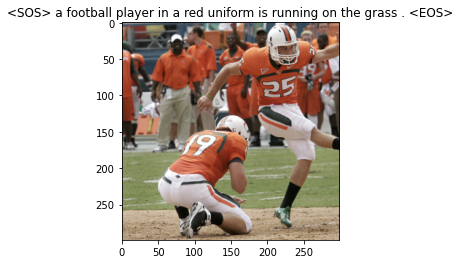

Actual caption = ['<SOS>', 'a', '<UNK>', '<UNK>', 'dog', 'benches', 'disc', 'beach', 'dog', '<UNK>', '<UNK>', 'grass', 'golden', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'football', 'player', 'in', 'a', 'red', 'uniform', 'is', 'running', 'on', 'the', 'grass', '.', '<EOS>']
0.678518533706665
***************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

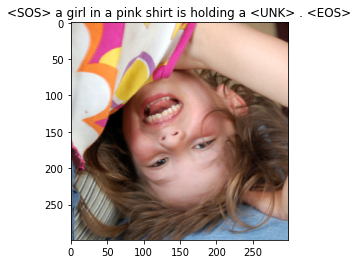

Actual caption = ['<SOS>', 'a', 'foot', 'down', 'person', 'run', '-', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'holding', 'a', '<UNK>', '.', '<EOS>']
0.726767361164093
*******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

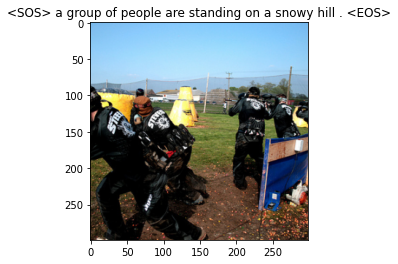

Actual caption = ['<SOS>', 'a', 'newspaper', 'trail', '<UNK>', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'standing', 'on', 'a', 'snowy', 'hill', '.', '<EOS>']
0.6803749203681946
*****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

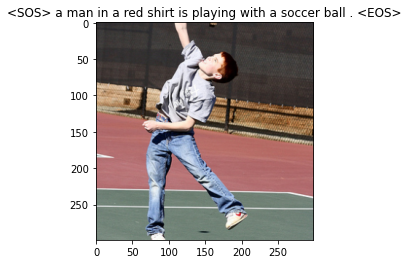

Actual caption = ['<SOS>', 'warm', 'girl', 'dog', '<UNK>', 'black', 'grass', 'lined', '<UNK>', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'playing', 'with', 'a', 'soccer', 'ball', '.', '<EOS>']
0.5940151214599609
**************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

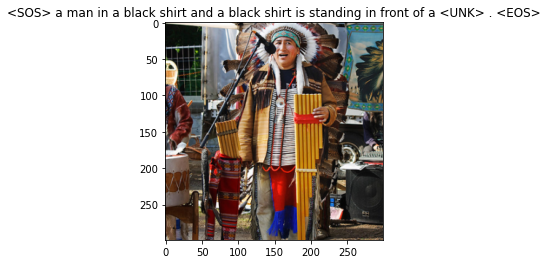

Actual caption = ['<SOS>', 'toy', 'snowboarding', '<UNK>', 'is', 'carpet', 'kids', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'a', 'black', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.6168972253799438
*******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

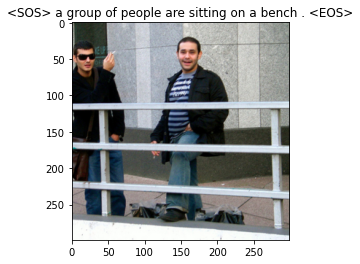

Actual caption = ['<SOS>', 'sitting', 'runs', 'helping', 'beach', 'looks', 'train', 'a', 'basketball', 'is', 'skateboard', 'black', 'a', 'onto', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'sitting', 'on', 'a', 'bench', '.', '<EOS>']
0.6147881746292114
*************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

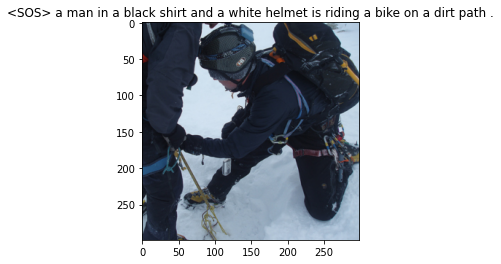

Actual caption = ['<SOS>', 'another', '<UNK>', 'girl', '<UNK>', 'little', 'dog', 'climbs', 'shorts', 'white', 'horse', '<UNK>', 'hanging', 'girl', 'looks', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'a', 'white', 'helmet', 'is', 'riding', 'a', 'bike', 'on', 'a', 'dirt', 'path', '.']
0.4710414707660675
***********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

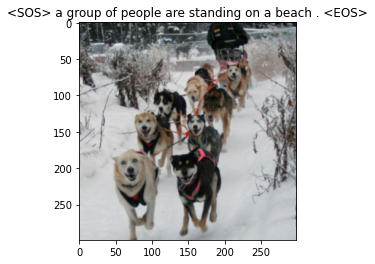

Actual caption = ['<SOS>', 'a', 'log', 'black', '<UNK>', 'painting', 'camera', 'dog', 'unicycle', 'climbs', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'standing', 'on', 'a', 'beach', '.', '<EOS>']
0.7763378620147705
*******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

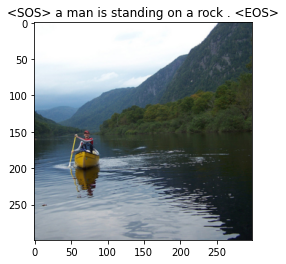

Actual caption = ['<SOS>', 'a', 'the', 'little', 'a', '<UNK>', 'playground', '<UNK>', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'is', 'standing', 'on', 'a', 'rock', '.', '<EOS>']
0.8103253841400146
**********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

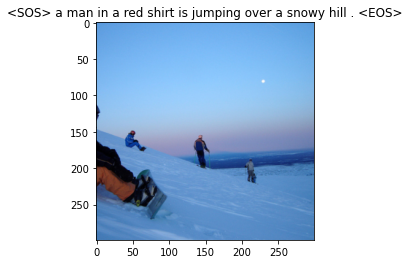

Actual caption = ['<SOS>', 'a', 'hose', 'boys', 'little', 'a', 'beige', 'and', 'tunnel', 'of', '<UNK>', 'bicycles', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'jumping', 'over', 'a', 'snowy', 'hill', '.', '<EOS>']
0.746381938457489
*******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

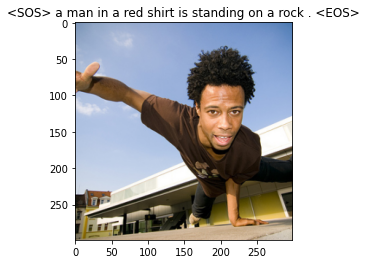

Actual caption = ['<SOS>', 'a', 'the', 'shepherd', 'older', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'standing', 'on', 'a', 'rock', '.', '<EOS>']
0.7593673467636108
*********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

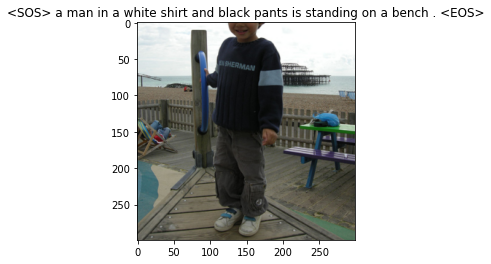

Actual caption = ['<SOS>', 'bench', 'is', 'boy', 'volleyball', 'and', 'on', '<UNK>', 'little', '<UNK>', 'looks', 'little', 'wears', '<UNK>', 'biker', 'and', 'tree', 'black', 'young', 'is', 'dog', 'lake', 'in', '<EOS>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'white', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'on', 'a', 'bench', '.', '<EOS>']
0.0
*****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

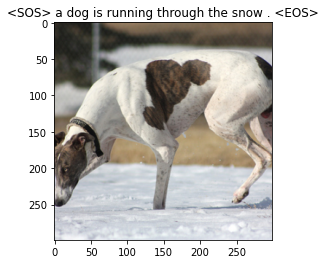

Actual caption = ['<SOS>', 'a', 'face', '<UNK>', 'on', 'overpass', 'man', '<UNK>', 'dog', 'looking', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'the', 'snow', '.', '<EOS>']
0.742749810218811
*****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

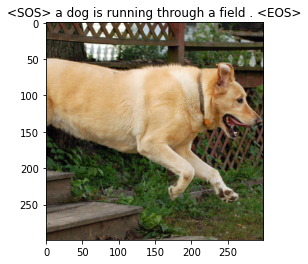

Actual caption = ['<SOS>', 'a', 'man', 'fight', ',', 'dog', 'bar', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'a', 'field', '.', '<EOS>']
0.8342292904853821
************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

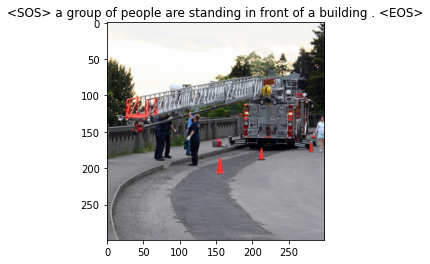

Actual caption = ['<SOS>', 'a', '<UNK>', 'and', 'course', '<UNK>', 'little', 'dog', 'sand', 'black', 'dog', 'car', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'standing', 'in', 'front', 'of', 'a', 'building', '.', '<EOS>']
0.696628212928772
****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

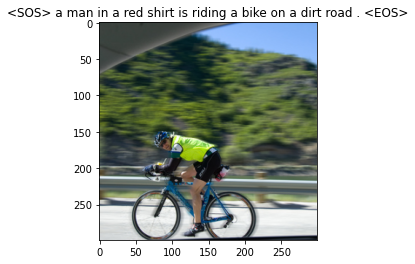

Actual caption = ['<SOS>', 'a', 'into', 'cellphone', 'is', 'boy', 'laughing', 'fenced', 'bird', 'a', 'car', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'riding', 'a', 'bike', 'on', 'a', 'dirt', 'road', '.', '<EOS>']
0.600963830947876
***************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

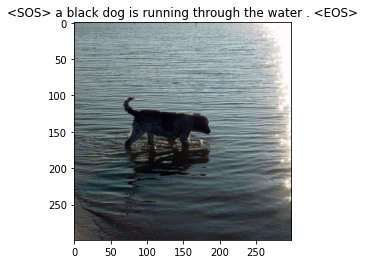

Actual caption = ['<SOS>', 'a', 'man', 'lab', 'by', 'dog', '<UNK>', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'black', 'dog', 'is', 'running', 'through', 'the', 'water', '.', '<EOS>']
0.8028097152709961
*********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

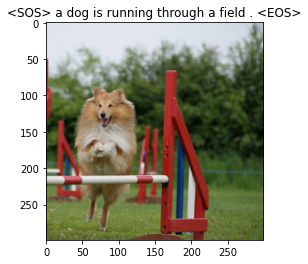

Actual caption = ['<SOS>', 'dog', 'man', 'girl', 'over', 'one', 'dog', '<UNK>', 'rocks', 'a', '.', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'a', 'field', '.', '<EOS>']
0.6455651521682739
*******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

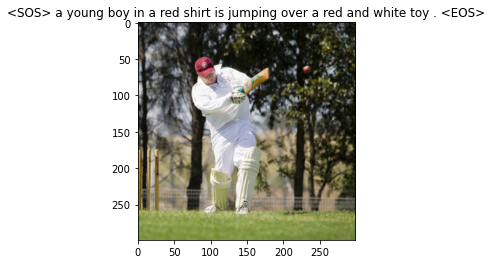

Actual caption = ['<SOS>', 'a', 'the', 'is', 'a', 'shower', 'attempting', 'bite', 'a', 'for', 'is', 'a', 'him', 'frozen', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'boy', 'in', 'a', 'red', 'shirt', 'is', 'jumping', 'over', 'a', 'red', 'and', 'white', 'toy', '.', '<EOS>']
0.5035337805747986
********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

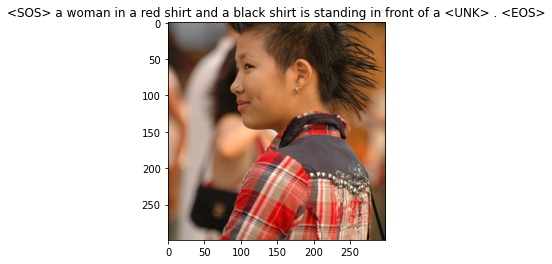

Actual caption = ['<SOS>', 'a', 'person', 'and', 'a', 'leaping', 'dock', 'yellow', '<UNK>', 'yellow', 'of', 'bandanna', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'woman', 'in', 'a', 'red', 'shirt', 'and', 'a', 'black', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.4916776418685913
***************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

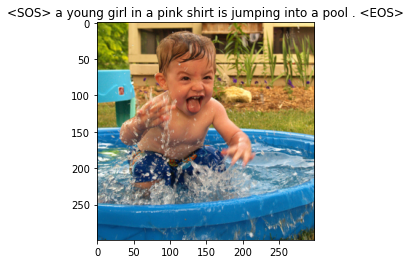

Actual caption = ['<SOS>', 'ice', 'is', 'lit', 'pole', 'branch', 'young', 'yellow', 'cup', 'climbing', 'walk', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'jumping', 'into', 'a', 'pool', '.', '<EOS>']
0.6383107900619507
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

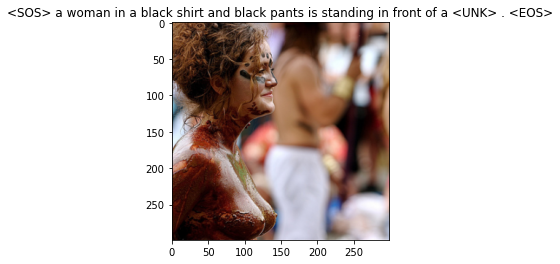

Actual caption = ['<SOS>', 'going', '.', 'around', 'is', 'shaking', 'is', 'posing', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'woman', 'in', 'a', 'black', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.5512003302574158
***************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

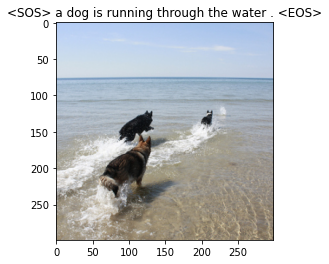

Actual caption = ['<SOS>', 'rock', 'people', 'field', 'orange', 'is', 'dog', 'young', 'little', 'dog', 'catch', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'the', 'water', '.', '<EOS>']
0.7372197508811951
**********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

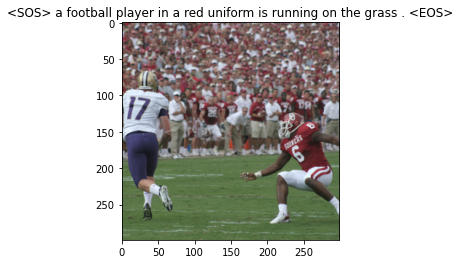

Actual caption = ['<SOS>', 'a', 'kid', 'benches', 'life', 'german', 'just', 'little', 'dog', 'frozen', 'other', 'horse', 'life', 'laying', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'football', 'player', 'in', 'a', 'red', 'uniform', 'is', 'running', 'on', 'the', 'grass', '.', '<EOS>']
0.5847065448760986
*******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

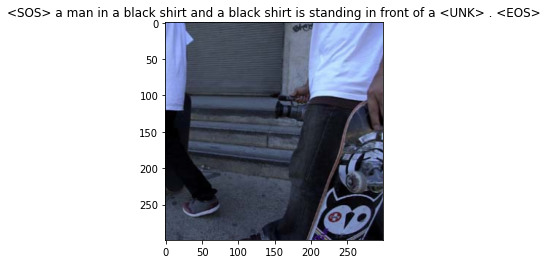

Actual caption = ['<SOS>', 'sitting', 'playing', 'are', 'on', 'distance', 'of', 'subway', 'light', 'skier', 'a', 'path', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'a', 'black', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.4416416585445404
*****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

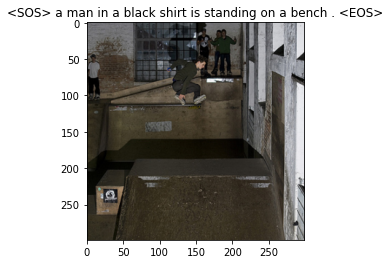

Actual caption = ['<SOS>', 'a', 'the', 'cliff', 'sidewalk', 'is', 'front', 'cut', 'a', 'very', 'little', 'a', 'basketball', 'beach', 'are', '<UNK>', 'bus', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'is', 'standing', 'on', 'a', 'bench', '.', '<EOS>']
0.5885661840438843
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

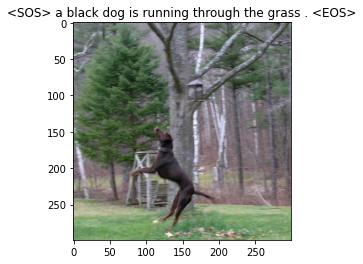

Actual caption = ['<SOS>', 'a', 'face', 'man', 'girl', 'take', 'standing', 'dog', 'behind', 'is', 'skateboard', 'black', 'a', 'sandy', 'cow', 'is', 'a', '<UNK>', 'costumed', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'black', 'dog', 'is', 'running', 'through', 'the', 'grass', '.', '<EOS>']
0.4949232041835785
********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

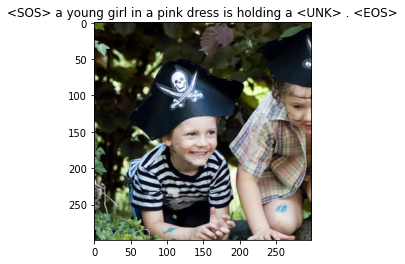

Actual caption = ['<SOS>', 'sitting', 'through', 'baby', 'field', '<UNK>', 'is', 'dog', 'bottom', 'are', 'laughs', 'line', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'holding', 'a', '<UNK>', '.', '<EOS>']
0.745887815952301
**************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

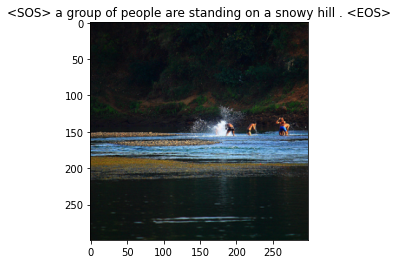

Actual caption = ['<SOS>', 'art', 'playing', 'field', 'is', 'a', '<UNK>', 'young', '<UNK>', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'standing', 'on', 'a', 'snowy', 'hill', '.', '<EOS>']
0.6797016263008118
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

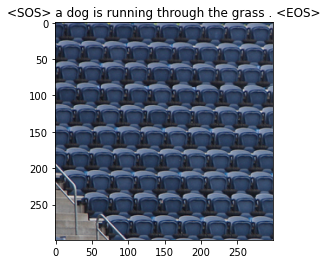

Actual caption = ['<SOS>', 'sitting', 'playing', 'is', 'boy', 'green', 'is', 'toy', '<UNK>', 'bicyclists', 'creek', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'the', 'grass', '.', '<EOS>']
0.660632848739624
*******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

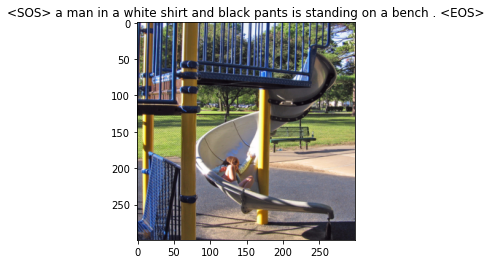

Actual caption = ['<SOS>', 'a', 'dogs', 'person', 'girl', 'tennis', 'down', 'a', 'walking', 'at', 'a', 'smiling', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'white', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'on', 'a', 'bench', '.', '<EOS>']
0.720151960849762
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

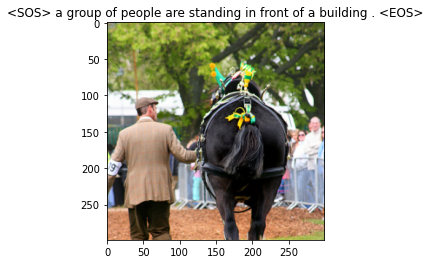

Actual caption = ['<SOS>', 'the', 'is', 'face', 'head', 'wheel', 'front', 'racer', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'standing', 'in', 'front', 'of', 'a', 'building', '.', '<EOS>']
0.8016127347946167
***********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

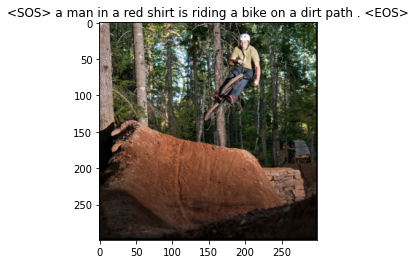

Actual caption = ['<SOS>', 'a', 'the', 'are', 'a', 'busy', 'face', 'near', 'girl', 'ground', 'a', 'several', 'into', 'is', 'dog', 'way', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'riding', 'a', 'bike', 'on', 'a', 'dirt', 'path', '.', '<EOS>']
0.624054491519928
*************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

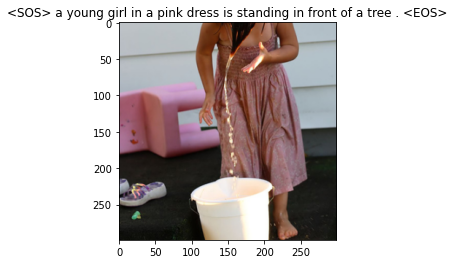

Actual caption = ['<SOS>', 'a', 'through', 'person', '<UNK>', 'overlooking', 'has', 'her', 'climbing', 'black', 'a', 'on', 'vests', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'standing', 'in', 'front', 'of', 'a', 'tree', '.', '<EOS>']
0.6384510397911072
*******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

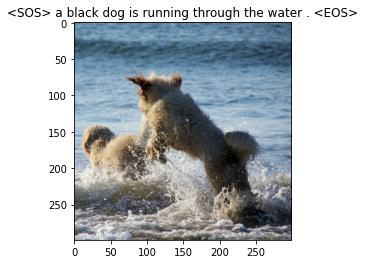

Actual caption = ['<SOS>', 'sitting', 'on', 'yellow', 'back', 'jumping', 'edge', 'people', 'an', 'is', 'dog', 'jumps', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'black', 'dog', 'is', 'running', 'through', 'the', 'water', '.', '<EOS>']
0.6934399008750916
***************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

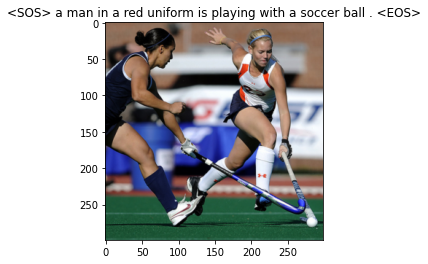

Actual caption = ['<SOS>', 'sitting', 'pigtails', 'field', 'time', 'and', 'cup', 'three', 'a', 'for', 'vest', 'a', 'skirt', 'play', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'uniform', 'is', 'playing', 'with', 'a', 'soccer', 'ball', '.', '<EOS>']
0.600963830947876
************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

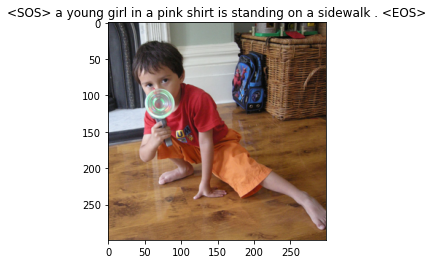

Actual caption = ['<SOS>', 'a', 'through', 'bench', 'and', 'grass', 'jean', 'foggy', '<UNK>', 'a', 'hat', 'at', 'dog', 'plays', 'is', 'skateboard', 'black', 'a', '<UNK>', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'standing', 'on', 'a', 'sidewalk', '.', '<EOS>']
0.5659119486808777
***************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

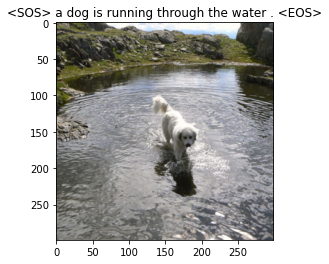

Actual caption = ['<SOS>', 'a', 'on', 'man', 'girl', 'lab', 'by', 'a', 'chalk', 'stand', 'laying', 'by', 'a', 'purple', 'spider', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'the', 'water', '.', '<EOS>']
0.7005534172058105
*******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

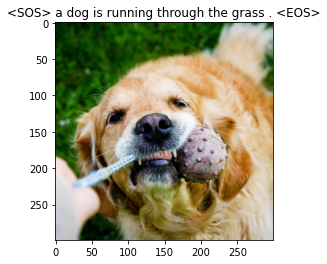

Actual caption = ['<SOS>', 'a', 'have', '<UNK>', 'mountain', 'and', 'a', 'hat', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'the', 'grass', '.', '<EOS>']
0.7981365919113159
*********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

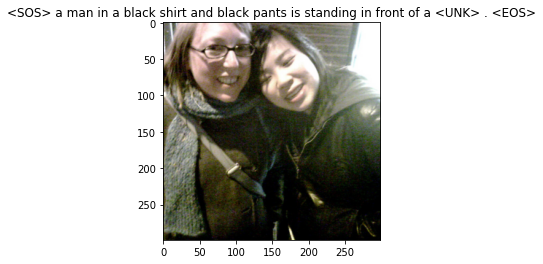

Actual caption = ['<SOS>', 'sitting', 'water', 'yellow', 'another', 'are', 'night', 'yellow', 'cliff', 'is', '<UNK>', '<UNK>', 'same', 'swimsuit', 'three', 'dog', 'plays', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.5053483247756958
*******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

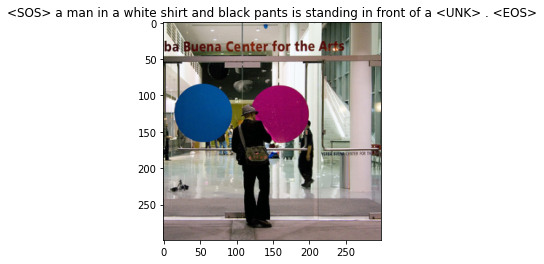

Actual caption = ['<SOS>', 'his', 'looks', 'at', 'sandals', '<UNK>', 'and', 'flowers', 'child', 'pitbull', 'of', 'flowers', 'rope', 'pitbull', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'white', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.708587646484375
****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

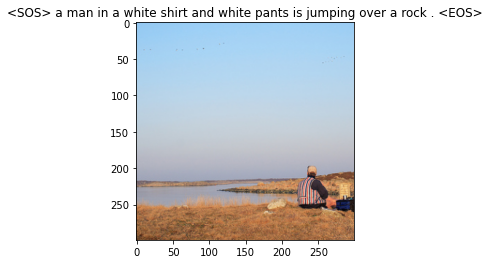

Actual caption = ['<SOS>', 'sitting', 'playing', 'and', 'buildings', 'each', 'at', 'a', 'wearing', 'beach', 'brown', 'little', 'a', 'jacket', 'jumping', '<UNK>', 'watching', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'white', 'shirt', 'and', 'white', 'pants', 'is', 'jumping', 'over', 'a', 'rock', '.', '<EOS>']
0.49344944953918457
****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

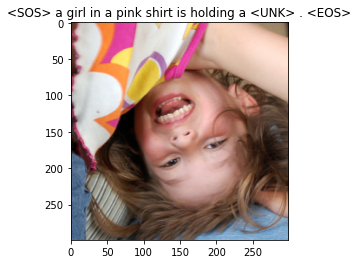

Actual caption = ['<SOS>', 'a', 'to', 'person', 'girl', 'lady', 'a', 'bags', 'beach', 'small', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'girl', 'in', 'a', 'pink', 'shirt', 'is', 'holding', 'a', '<UNK>', '.', '<EOS>']
0.7394115328788757
*****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

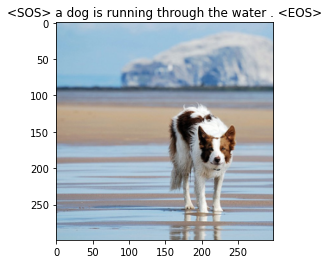

Actual caption = ['<SOS>', 'toy', '<UNK>', 'each', 'man', 'girl', 'looks', 'is', 'skateboard', 'black', 'a', 'court', '<UNK>', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'the', 'water', '.', '<EOS>']
0.6645209193229675
**********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

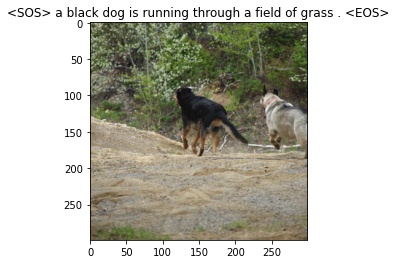

Actual caption = ['<SOS>', 'sitting', 'people', 'orange', 'beside', 'while', 'dog', 'plays', 'is', 'dog', 'way', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'black', 'dog', 'is', 'running', 'through', 'a', 'field', 'of', 'grass', '.', '<EOS>']
0.6934399008750916
**************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

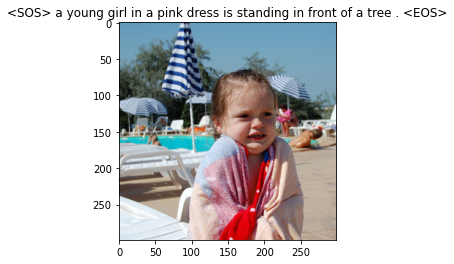

Actual caption = ['<SOS>', 'a', 'set', 'girl', 'and', 'has', 'her', 'high', 'train', 'many', 'pole', '<UNK>', 'is', 'a', 'wear', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'standing', 'in', 'front', 'of', 'a', 'tree', '.', '<EOS>']
0.5873948931694031
*******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

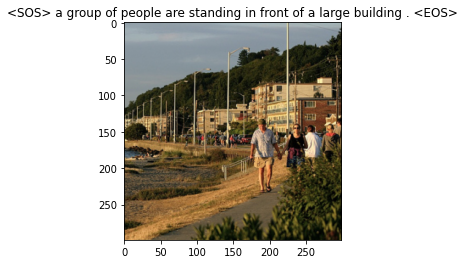

Actual caption = ['<SOS>', 'playing', 'lab', 'down', 'inflatable', 'rocks', 'young', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'group', 'of', 'people', 'are', 'standing', 'in', 'front', 'of', 'a', 'large', 'building', '.', '<EOS>']
0.5013106465339661
************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

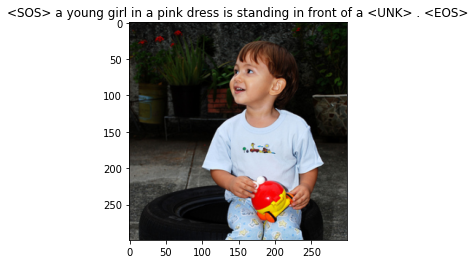

Actual caption = ['<SOS>', 'ice', 'snow', 'middle', 'as', 'boys', 'little', 'a', 'board', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'young', 'girl', 'in', 'a', 'pink', 'dress', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.6981959939002991
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

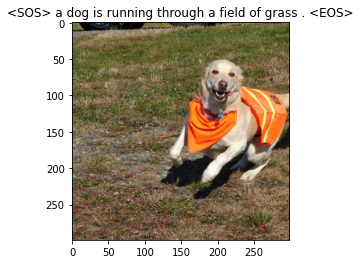

Actual caption = ['<SOS>', 'a', 'man', 'are', 'toy', 'net', 'leaning', '<UNK>', '<UNK>', 'camera', 'dog', 'next', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'dog', 'is', 'running', 'through', 'a', 'field', 'of', 'grass', '.', '<EOS>']
0.6139776110649109
**********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

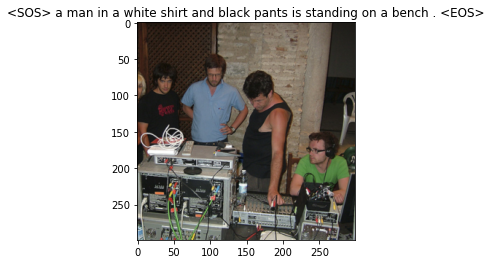

Actual caption = ['<SOS>', 'playing', 'track', 'rainbow', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'white', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'on', 'a', 'bench', '.', '<EOS>']
0.5302459597587585
****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

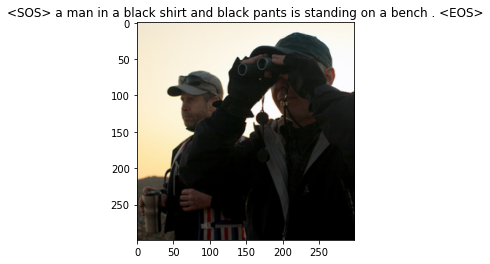

Actual caption = ['<SOS>', 'sitting', 'runs', 'street', 'climbing', 'other', 'another', 'girl', 'snow', 'sky', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'on', 'a', 'bench', '.', '<EOS>']
0.5592598915100098
********************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

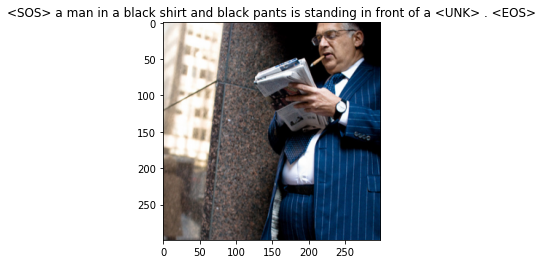

Actual caption = ['<SOS>', 'a', 'the', 'looks', 'train', 'a', 'onto', 'past', 'of', 'backpacks', 'a', 'vehicles', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'black', 'pants', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.441791832447052
************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

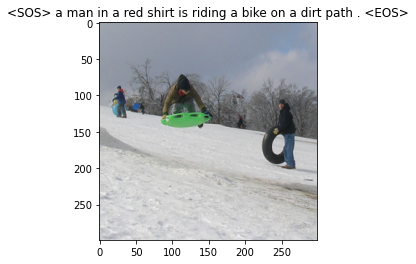

Actual caption = ['<SOS>', 'a', 'bench', 'ground', 'a', 'stands', ',', 'black', 'a', 'looking', 'sweater', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'red', 'shirt', 'is', 'riding', 'a', 'bike', 'on', 'a', 'dirt', 'path', '.', '<EOS>']
0.7415704131126404
******************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

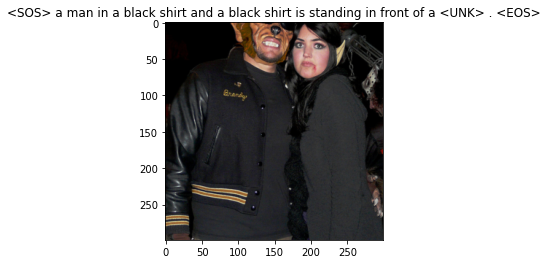

Actual caption = ['<SOS>', 'a', 'the', 'cliff', 'other', 'truck', '<UNK>', '<UNK>', 'truck', 'surfboard', 'a', '.', 'coming', 'two', 'away', 'a', '<UNK>', 'in', '<EOS>', '<PAD>', '<PAD>', '<PAD>']
Predicted caption = ['<SOS>', 'a', 'man', 'in', 'a', 'black', 'shirt', 'and', 'a', 'black', 'shirt', 'is', 'standing', 'in', 'front', 'of', 'a', '<UNK>', '.', '<EOS>']
0.5302459597587585
****************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************************

In [24]:
# Testing on Test set of Images
filename = "/content/drive/MyDrive/Visual Recognition/test_dataloader.p" # pratap
filehandler = open(filename, 'rb') 
data_loader_val = pickle.load(filehandler)
model1 = torch.load('/content/drive/MyDrive/Visual Recognition/Models/WithoutAttentionModel_Resnet18_BS_32_trial.pth')

with torch.no_grad():
  for idx, (image, ref_captions) in enumerate(iter(data_loader_val)):
    caption_needed =[]
    predicted_split_caps =[]
    features = model.encoder(image[0:1].to(device))
    caps = model.decoder.generate_caption(features.unsqueeze(0), vocab=data_loader.dataset.vocab)
    caption = ' '.join(caps)
    show_image(image[0],title=caption)
    caption_needed = [data_loader.dataset.vocab.itos[idx] if idx in data_loader.dataset.vocab.itos else  data_loader.dataset.vocab.itos[3] for idx in ref_captions[0].detach().numpy()]
    print('Actual caption =', caption_needed)
    predicted_split_caps = caption.split(' ')
    print('Predicted caption =', caption.split(' '))
    len_diff = abs(len(caption_needed) - len(predicted_split_caps))
    list_pad = ['<PAD>'] * len_diff
    if len(caption_needed) > len(predicted_split_caps):
      predicted_split_caps.extend(list_pad)
    else :
      caption_needed.extend(list_pad)
    predicted_split_caps.insert(0, '<SOS>')
    caption_needed = [[caption_needed]]
    predicted_split_caps =[predicted_split_caps]
    print(bleu_score(predicted_split_caps, caption_needed, max_n=2, weights=[0.25, 0.25]))
    print('*' * 1000)

In [29]:
transforms = T.Compose([
    # T.Resize(700),                     
    # T.RandomCrop(500),                 
    T.ToTensor(),                               
    T.Normalize((0.485, 0.456, 0.406),(0.229, 0.224, 0.225))
])
model.eval()
def predict_cap_subjective() :
  model1 = torch.load('/content/drive/MyDrive/Visual Recognition/Models/WithoutAttentionModel_Resnet18_BS_32_trial.pth')
  img_location = "/content/drive/MyDrive/Visual Recognition/subjective_img/"
  path, dirs, files = next(os.walk("/content/drive/MyDrive/Visual Recognition/subjective_img/"))
  for image in files:
    with torch.no_grad():
      img_loc = os.path.join(img_location,image)
      img = Image.open(img_loc).convert("RGB")
      img = transforms(img).unsqueeze(0)
      features = model.encoder(img[0:1].to(device))
      caps = model.decoder.generate_caption(features.unsqueeze(0),vocab=data_loader.dataset.vocab)
      caption = ' '.join(caps)
      show_image(img[0],title=caption)

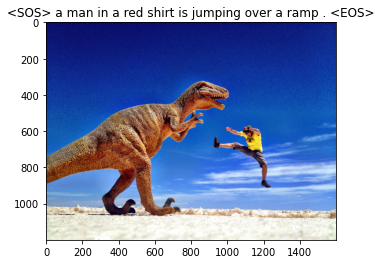

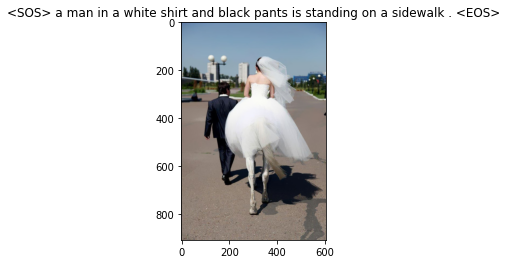

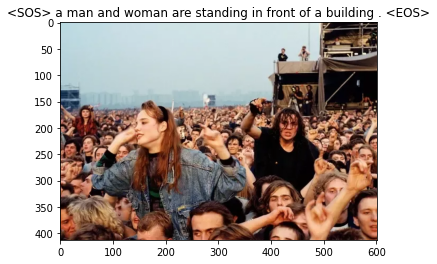

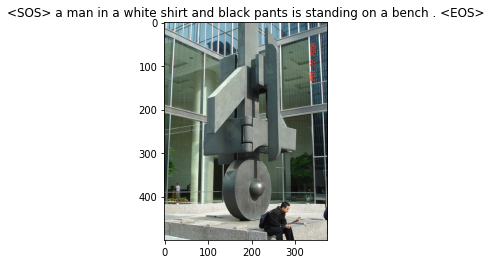

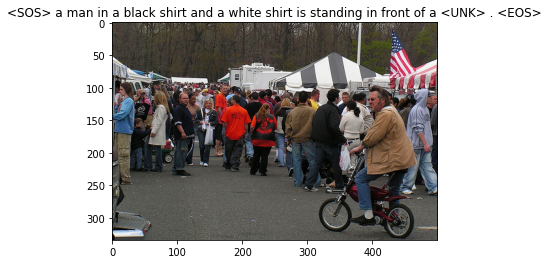

In [30]:
predict_cap_subjective()